# Temp Derivatives, US 13 stations


The daily average temperature in **CME** is measured as **the average of the daily minimum and maximum temperature**.

Notice these are actually avg of "block maxima" (BM) rather than discrete averages like (sum of Temp measurements)/ (num of measurements in a day).

BM are in the focus of extreme statistics: BM in stock markets has strong fat tails and are extremely exciting for financial engrs.

For mild stochastic processes like temperature, BM still has some unpredictabilities for us to play with, and the upper tail (due to global warming) can be unpredictable and profitable.

- univariate extremes
  1. baseline
     trend: polynomial (1st linear; 2nd quadaratic); LSE
     seasonality: fft; wavelet; LSE
  2. residuals: max/min/avg
- multivariate dependence (residuals)
  1. corr: vine
  2. tail dependence


# pickle


In [ ]:
import sys
import os
import pickle

currentdir = os.getcwd()

sys.path.append(os.path.join(currentdir, "script/wxderivs"))

from wxderivs import DIR_WORK

file_in = os.path.normpath(os.path.join(DIR_WORK, "../../out", "res_CDD_HDD.pkl"))
with open(file_in, "rb") as f:
    data_in = pickle.load(f)
print(data_in.keys())
dct_fit_res = data_in["dct_fit_res"]
df_evi_all = data_in["df_evi_all"]

dict_keys(['df_avg_all', 'df_max_all', 'df_min_all', 'dct_fit_res', 'df_y', 'df_y_pred', 'df_res', 'df_std', 'df_res_scaled', 'df_cdd', 'df_cdd_pred', 'df_cdd_res', 'df_hdd', 'df_hdd_pred', 'df_hdd_res', 'df_evi_all'])


In [3]:
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.fft as fft
import seaborn as sns
import torch
from scipy.stats import genextreme, genpareto, pareto
from wxderivs import (
    DIR_WORK,
    MONTH_CDD,
    MONTH_HDD,
    SET_CDD,
    SET_HDD,
    SET_USA,
    dct_name_file,
    fit_mean_std,
)

sys.path.append(str(DIR_WORK / "UniBM"))

import unibm
import unibm.benchmark

In [4]:
df_max_all = {}
df_min_all = {}
for name in SET_USA:
    tmp_df = pd.read_csv(dct_name_file[name])
    tmp_df.index = pd.to_datetime(tmp_df["DATE"])
    df_max_all[name] = tmp_df["DAILY_MAX_TEMP"]
    df_min_all[name] = tmp_df["DAILY_MIN_TEMP"]
df_max_all = pd.DataFrame(df_max_all)
df_min_all = pd.DataFrame(df_min_all)
df_avg_all = (df_max_all + df_min_all) / 2
df_y = df_avg_all
df_max_all.head()

""


# EDA: viz of max, min, avg, (max-min); all 13 US city


In [5]:
def plot_day_of_year(
    srs,
    is_day_of_year_frac=False,
    is_scatter=False,
    alpha=0.7,
    is_label=False,
    xlabel="Day of year",
    ylabel="Temperature",
    title="Temperature vs Day of year",
    axhline=[
        65,
    ],
    axvline_red=pd.DatetimeIndex(["2020-05-01", "2020-09-30"]).day_of_year.to_list(),
    axvline_blue=pd.DatetimeIndex(["2020-11-01", "2020-03-31"]).day_of_year.to_list(),
    ax=None,
):
    if is_day_of_year_frac:
        vec_t = (srs.index.day_of_year / (srs.index.is_leap_year + 365)).to_numpy()
    else:
        vec_t = srs.index.day_of_year.to_numpy()
    vec_y = srs.to_numpy()
    year_unique = srs.index.year.unique()
    cmap = plt.get_cmap("rainbow", len(year_unique))
    color_map = {year: cmap(i) for i, year in enumerate(year_unique)}
    if ax is None:
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    for year in year_unique:
        idx = srs.index.year == year
        if is_scatter:
            ax.scatter(
                vec_t[idx],
                vec_y[idx],
                s=1,
                color=color_map[year],
                alpha=alpha,
                label=year if is_label else None,
            )
        else:
            ax.plot(
                vec_t[idx],
                vec_y[idx],
                label=year,
                alpha=alpha,
                lw=1,
                c=color_map[year],
                linestyle="-.",
            )
    if axhline:
        for _ in axhline:
            ax.axhline(_, color="black", linestyle="--", lw=0.9)
    if axvline_red:
        for _ in axvline_red:
            ax.axvline(_, color="red", linestyle="--", lw=0.9)
    if axvline_blue:
        for _ in axvline_blue:
            ax.axvline(_, color="blue", linestyle="--", lw=0.9)
    ax.grid()
    if is_label:
        ax.legend()
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    return ax

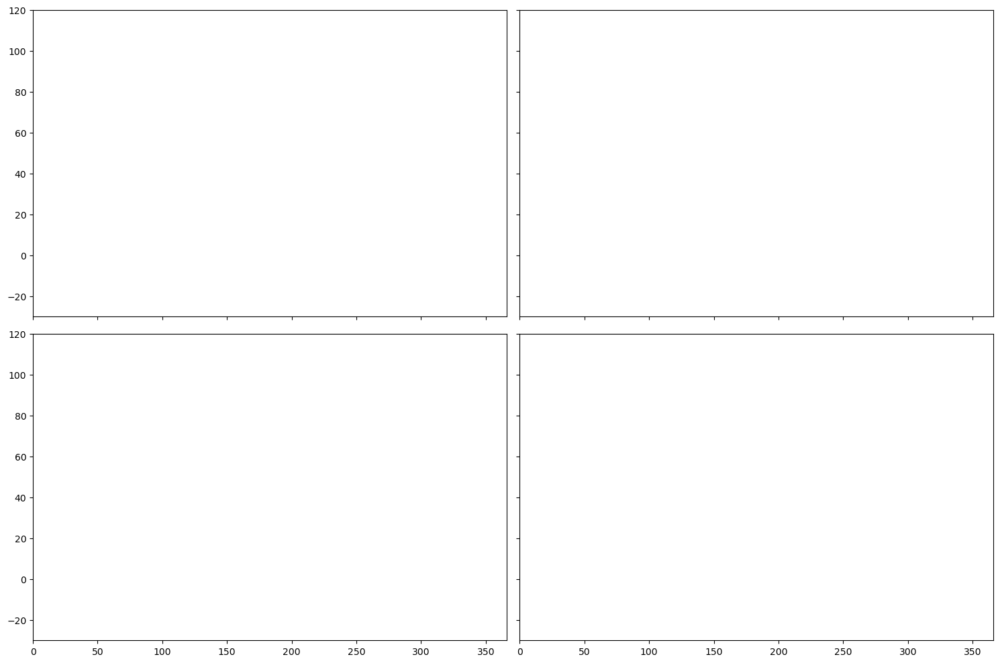

In [6]:
import os
os.environ['KMP_DUPLICATE_LIB_OK'] = 'TRUE'

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), sharex=True, sharey=True)
for station in SET_USA:
    plot_day_of_year(
        df_max_all[station],
        is_scatter=True,
        title="Daily max temp ~ day in year, obs from 13 stations in the US",
        ax=axes[0, 0],
    )
    plot_day_of_year(
        df_min_all[station],
        is_scatter=True,
        title="Daily min temp ~ day in year, obs from 13 stations in the US",
        ax=axes[0, 1],
    )
    plot_day_of_year(
        (df_max_all[station] + df_min_all[station]) / 2,
        is_scatter=True,
        title="Daily avg temp ~ day in year, obs from 13 stations in the US",
        ax=axes[1, 0],
    )
    plot_day_of_year(
        df_max_all[station] - df_min_all[station],
        is_scatter=True,
        title="Daily range temp ~ day in year, obs from 13 stations in the US",
        ax=axes[1, 1],
        axhline=None,
    )
for ax in axes.flatten():
    ax.set_xlim(0, 366)
    ax.set_ylim(-30, 120)
plt.tight_layout()

> comment
>
> the spread (range) as DailyMax-DailyMin looks homoscedastic across years.


# EDA: max in CDD months, min in HDD months


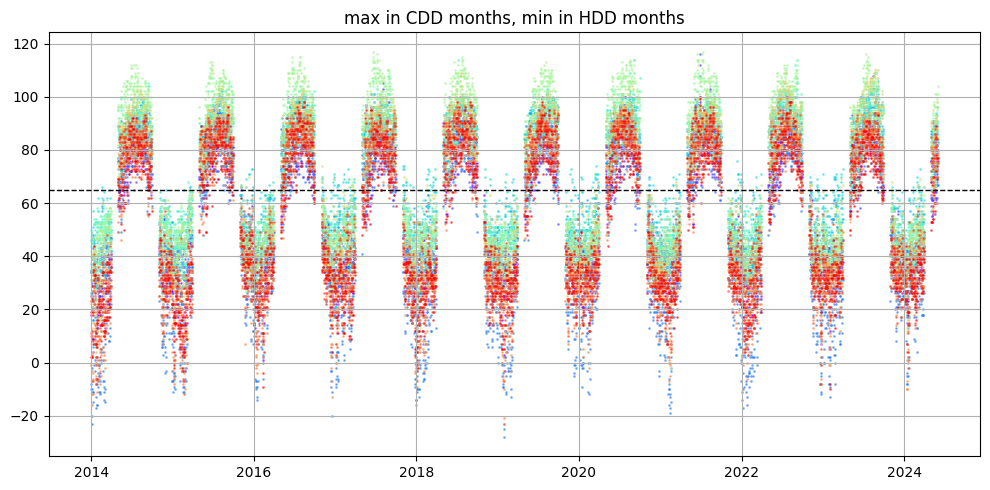

In [7]:
cmap = plt.get_cmap("rainbow", len(SET_USA))
color_map = {year: cmap(i) for i, year in enumerate(SET_USA)}
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
for station in SET_USA:
    idx = df_max_all.index.month.isin(MONTH_CDD)
    ax.scatter(
        df_max_all[idx].index,
        df_max_all[idx][station],
        s=1,
        alpha=0.5,
        color=color_map[station],
        label=f"max, CDD months, {station}",
    )
    idx = df_min_all.index.month.isin(MONTH_HDD)
    ax.scatter(
        df_min_all[idx].index,
        df_min_all[idx][station],
        s=1,
        alpha=0.5,
        color=color_map[station],
        label=f"min, HDD months, {station}",
    )
plt.axhline(65, color="black", linestyle="--", lw=1)
plt.title("max in CDD months, min in HDD months")
# plt.legend()
plt.grid()
plt.tight_layout()

# EDA: FFT power spectrum


avg temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

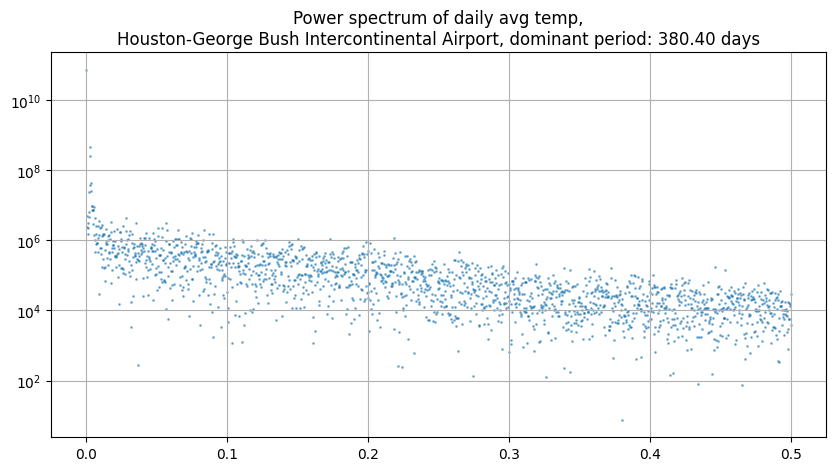

In [8]:
# for station in SET_USA:
station = "Houston-George Bush Intercontinental Airport"
tmp_df_filtered = df_avg_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

max temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

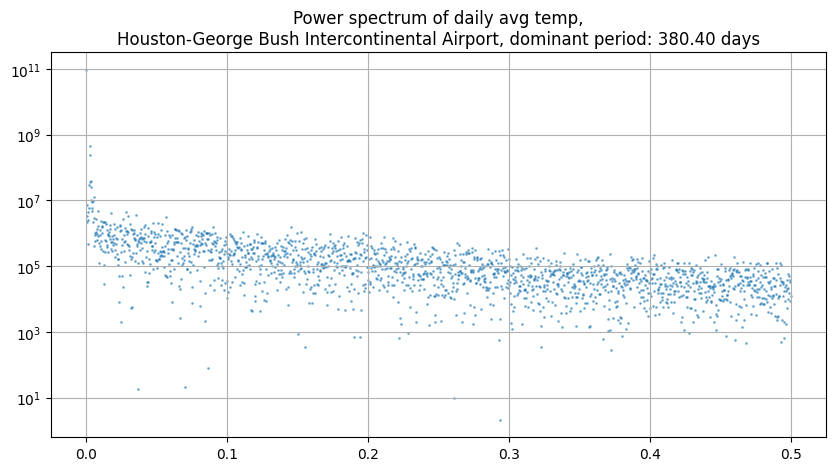

In [8]:
# for station in SET_USA:
tmp_df_filtered = df_max_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

min temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

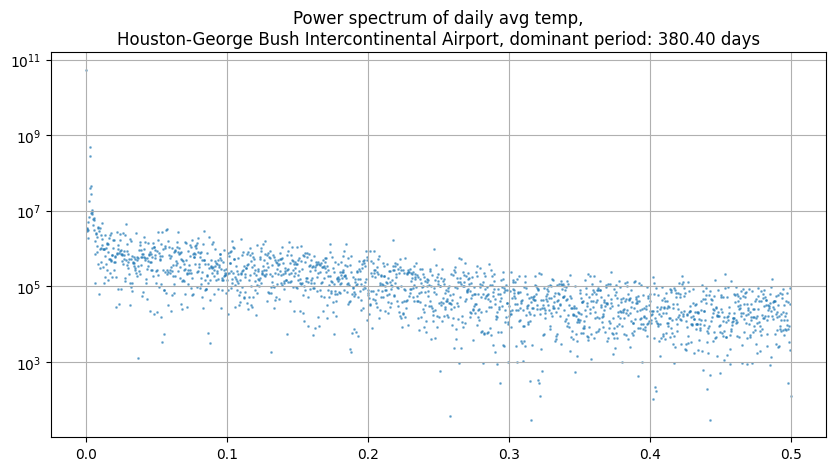

In [9]:
# for station in SET_USA:
tmp_df_filtered = df_min_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

# Univariate Extremes


## baseline and seasonality: Avg Temp


In [ ]:
dct_fit_res = {}
for station in SET_USA:
    dct_fit_res[station] = fit_mean_std(
        srs=(df_max_all[station] + df_min_all[station]) / 2
    )

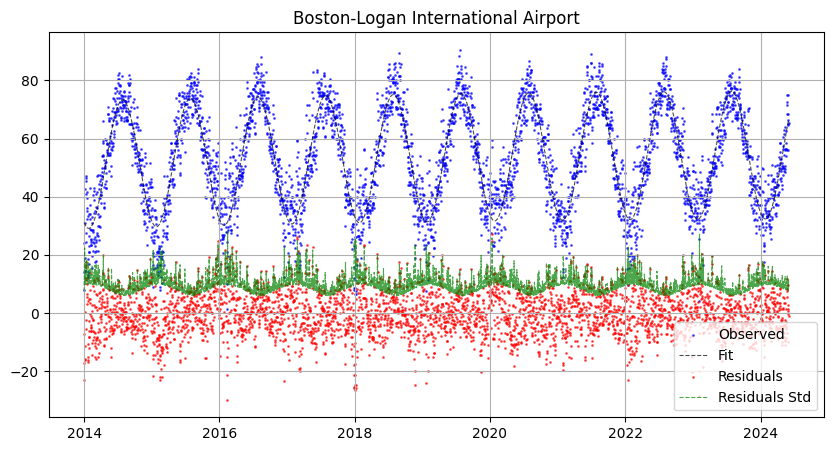

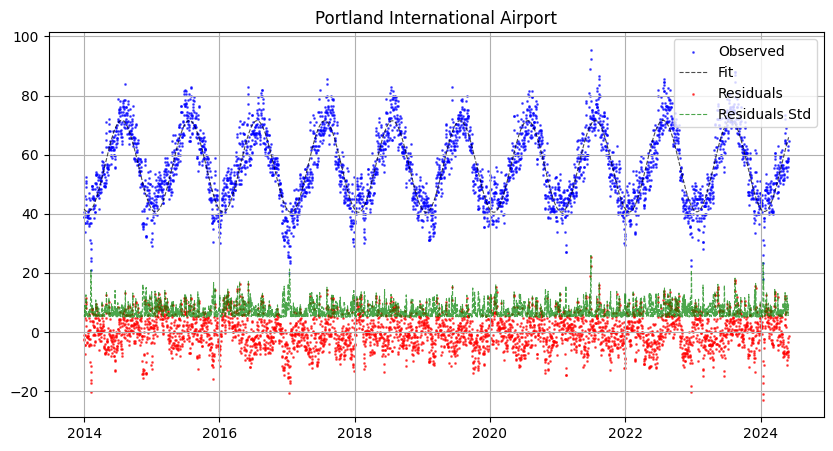

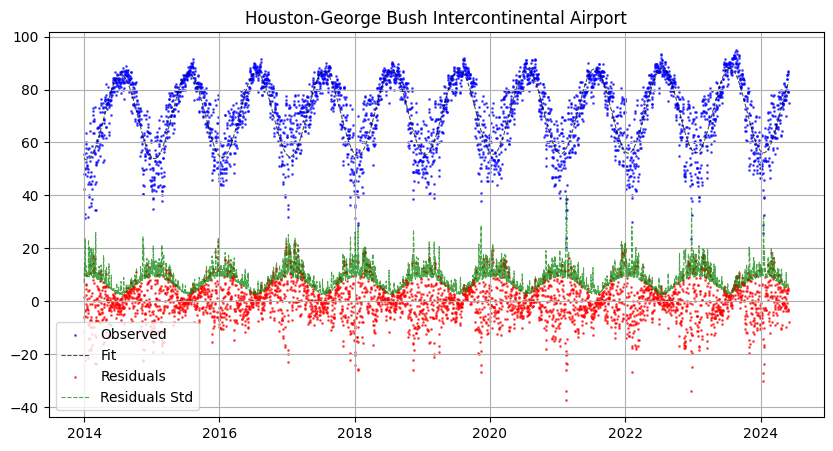

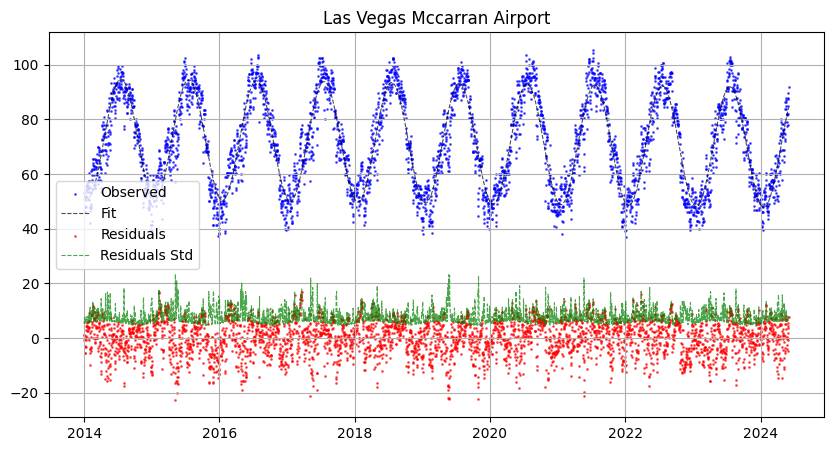

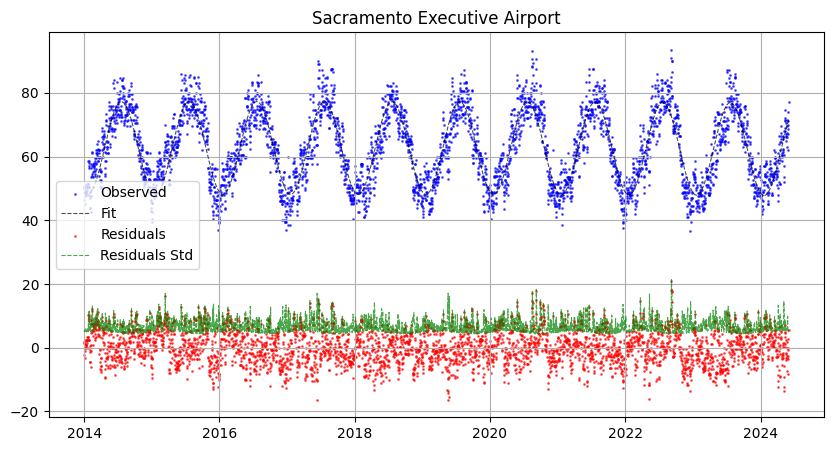

...

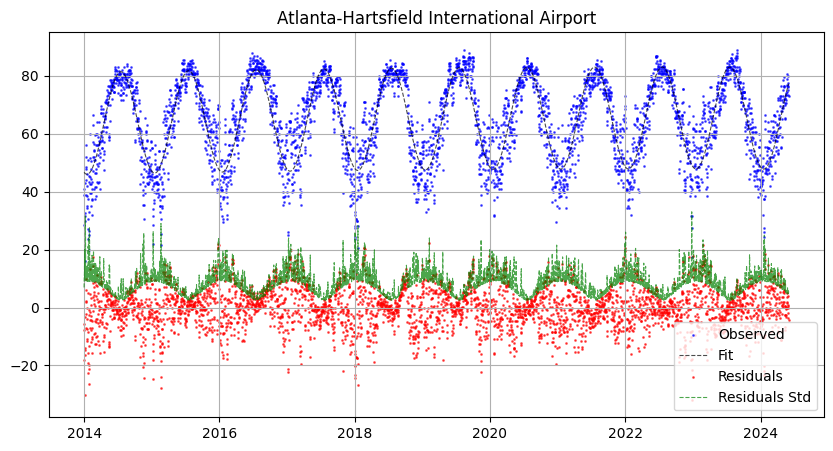

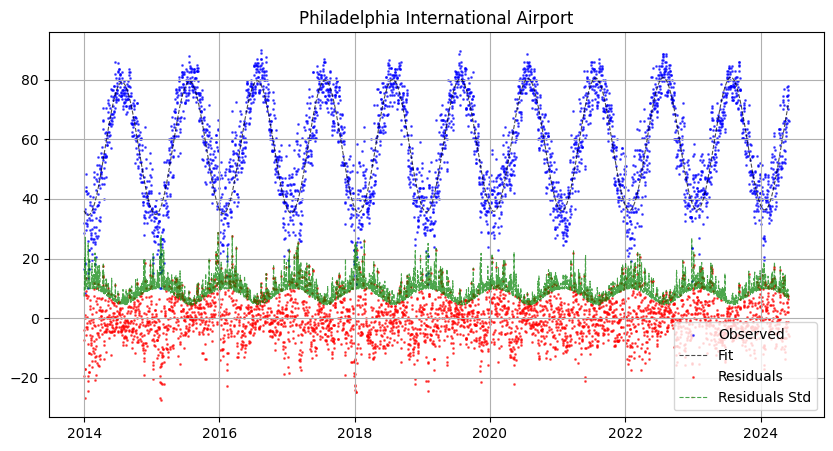

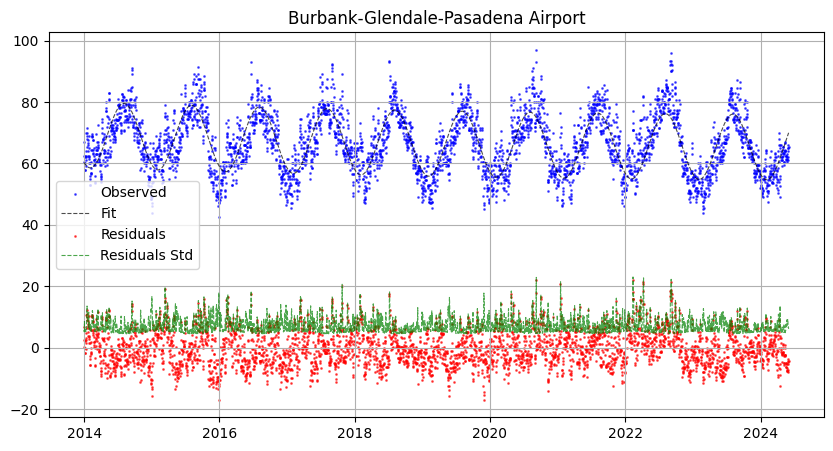

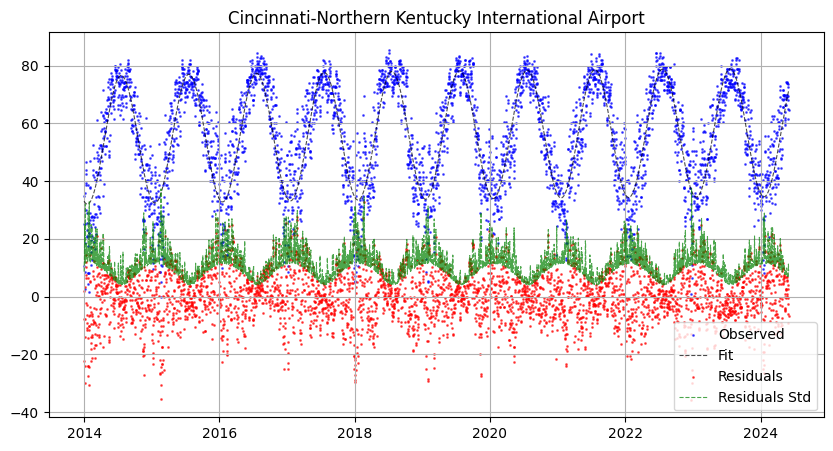

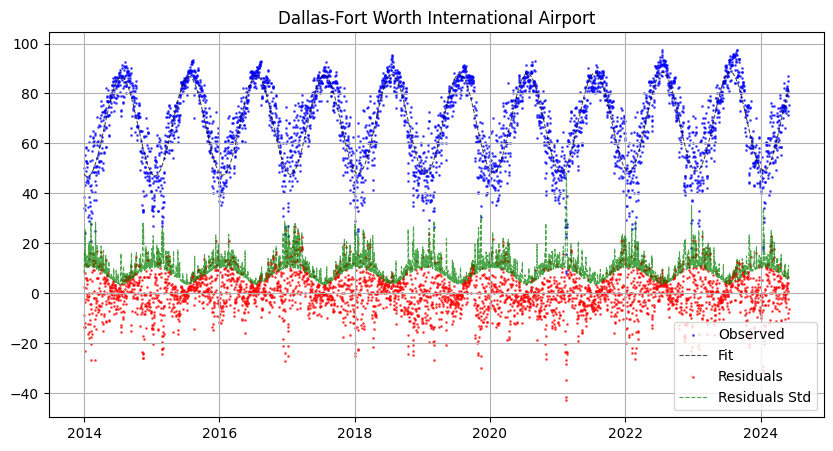

In [ ]:
for station in SET_USA:
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    ax.set_title(f"{station}")
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_y"],
        s=1,
        color="blue",
        alpha=0.6,
        label="Observed",
    )
    ax.plot(
        dct_fit_res[station]["vec_index"],
        dct_fit_res[station]["vec_y_pred"],
        linewidth=0.8,
        alpha=0.7,
        label="Fit",
        color="black",
        linestyle="--",
    )
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_res"],
        s=1,
        color="red",
        alpha=0.6,
        label="Residuals",
    )
    ax.plot(
        dct_fit_res[station]["vec_index"],
        dct_fit_res[station]["vec_std"],
        linewidth=0.8,
        alpha=0.7,
        label="Residuals Std",
        color="green",
        linestyle="--",
    )
    ax.grid(True)
    ax.legend()

## show rescaled std.dev.

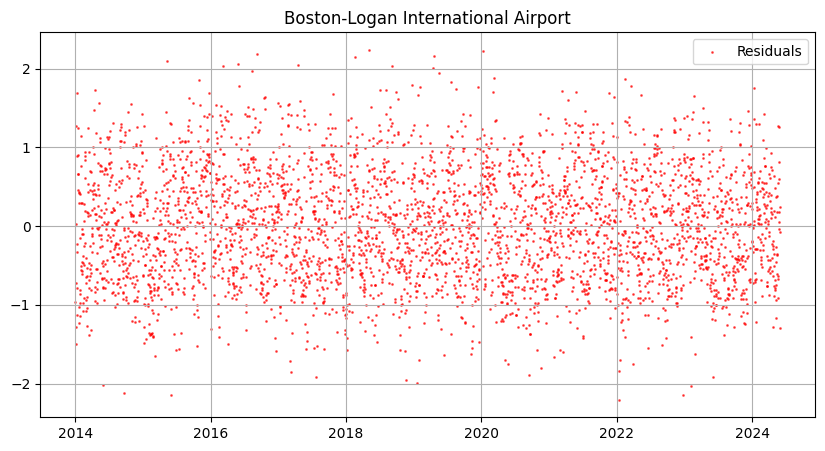

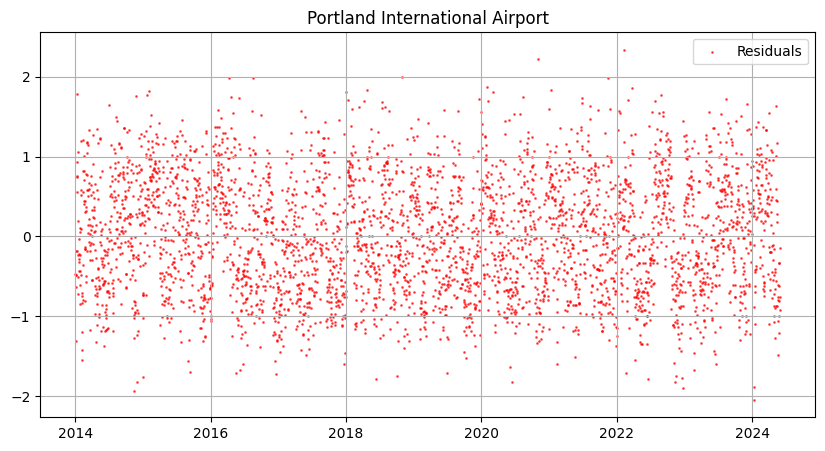

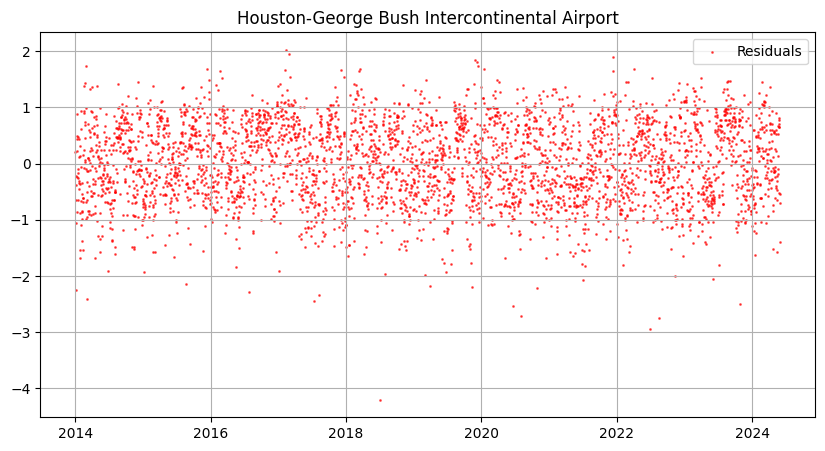

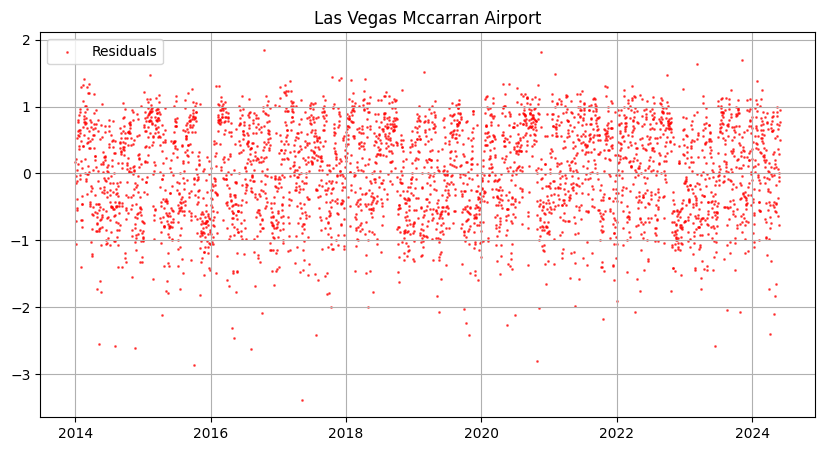

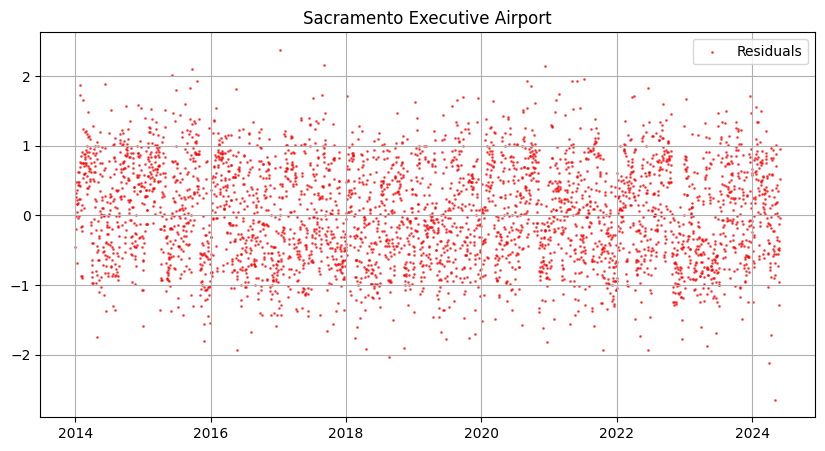

...

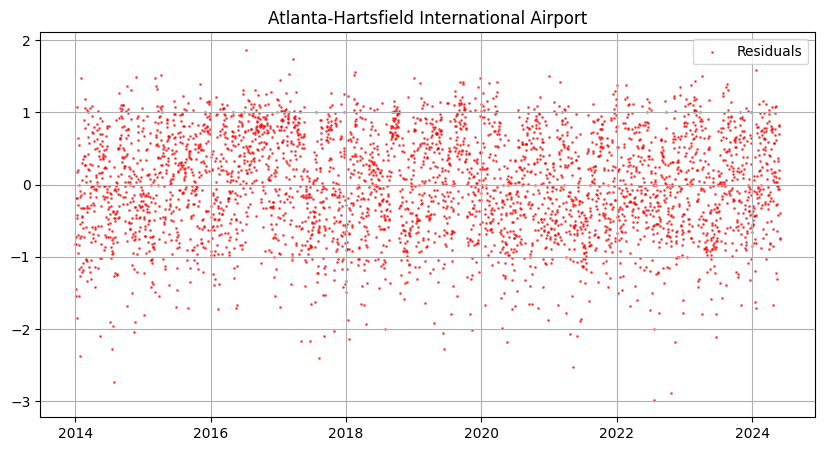

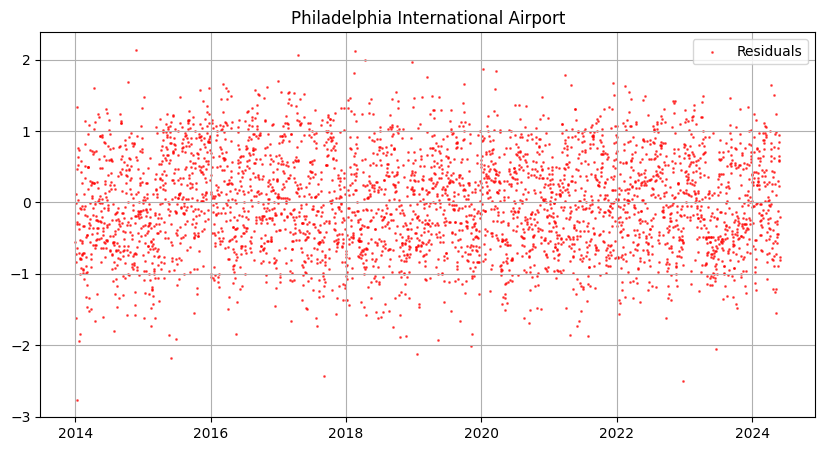

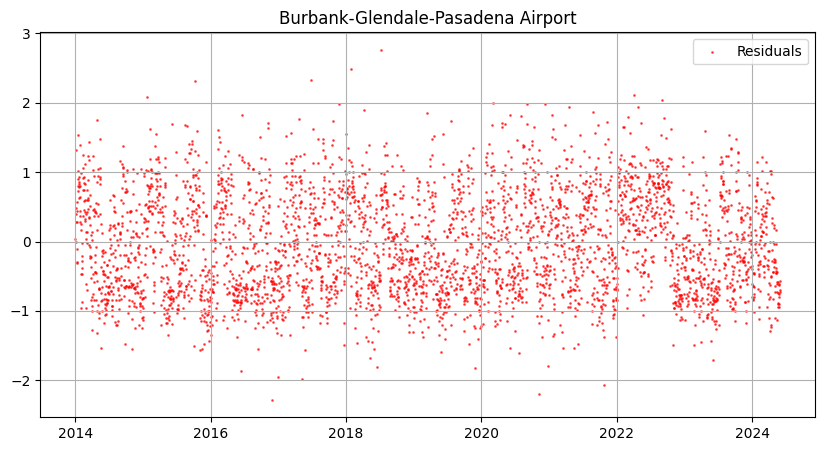

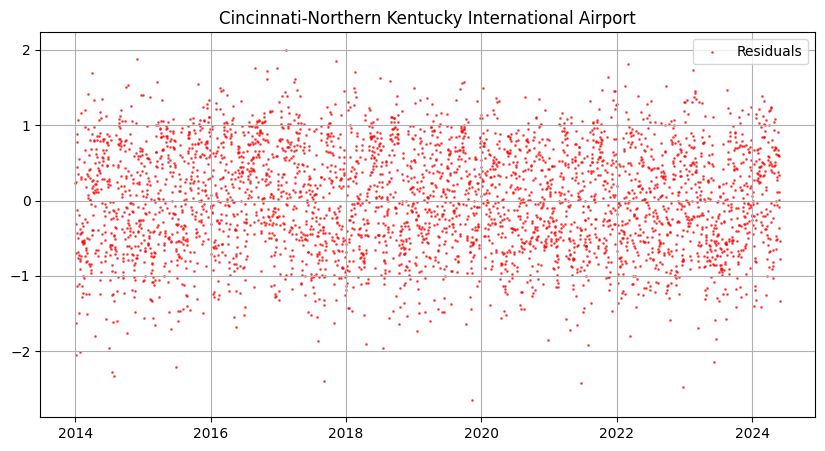

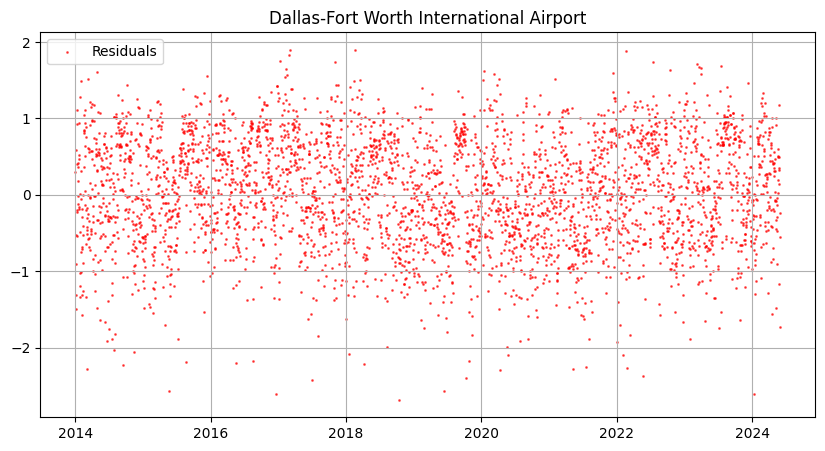

In [11]:
for station in SET_USA:
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    ax.set_title(f"{station}")
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_res_scaled"],
        s=1,
        color="red",
        alpha=0.6,
        label="Residuals",
    )
    ax.grid(True)
    ax.legend()

## show phase_1 phase_2 coeffs are consistent (low std/mean) across 13 US stations


,intercept,slope,quadratic,amplitude_1,phase_1,amplitude_2,phase_2,amplitude_3,phase_3,amplitude_4,phase_4,omega,alpha,beta
count,13.000000,13.000000,1.300000e+01,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,1.300000e+01
mean,59.486166,0.000675,-8.473637e-08,-8.217448,0.183283,-11.785871,0.945788,-4.268900,0.464777,18.202630,0.328381,50.159776,0.965262,3.375170e-05
std,8.588918,0.001630,3.080002e-07,2.345121,0.015377,3.422792,0.016147,20.383109,0.334409,34.700742,0.338035,19.955505,0.066309,6.649161e-05
min,46.407080,-0.001875,-4.586244e-07,-11.379221,0.151986,-18.402444,0.900590,-27.158861,0.003183,-42.323588,0.000007,22.908228,0.787576,1.000000e-10
25%,53.525920,-0.000437,-3.470336e-07,-10.940846,0.172594,-13.770867,0.942236,-25.016911,0.275120,-3.757760,0.010268,29.987298,0.973899,1.000000e-10
50%,57.190921,0.001448,-2.026597e-07,-7.088060,0.190394,-11.545862,0.950875,-6.506788,0.437206,18.783402,0.284300,55.543128,0.999953,1.000000e-10
75%,67.590604,0.002174,1.740803e-07,-6.312628,0.196288,-10.420731,0.953624,12.763859,0.629678,48.169917,0.501085,65.319153,1.000000,1.000047e-10
max,72.382903,0.002269,4.143321e-07,-5.419799,0.199968,-4.148064,0.967821,29.801215,0.999995,61.972900,0.937154,79.063670,1.000000,1.744127e-04


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'slope'}>,
        <Axes: title={'center': 'quadratic'}>,
        <Axes: title={'center': 'amplitude_1'}>],
       [<Axes: title={'center': 'phase_1'}>,
        <Axes: title={'center': 'amplitude_2'}>,
        <Axes: title={'center': 'phase_2'}>,
        <Axes: title={'center': 'amplitude_3'}>],
       [<Axes: title={'center': 'phase_3'}>,
        <Axes: title={'center': 'amplitude_4'}>,
        <Axes: title={'center': 'phase_4'}>,
        <Axes: title={'center': 'omega'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'beta'}>, <Axes: >, <Axes: >]],
      dtype=object)

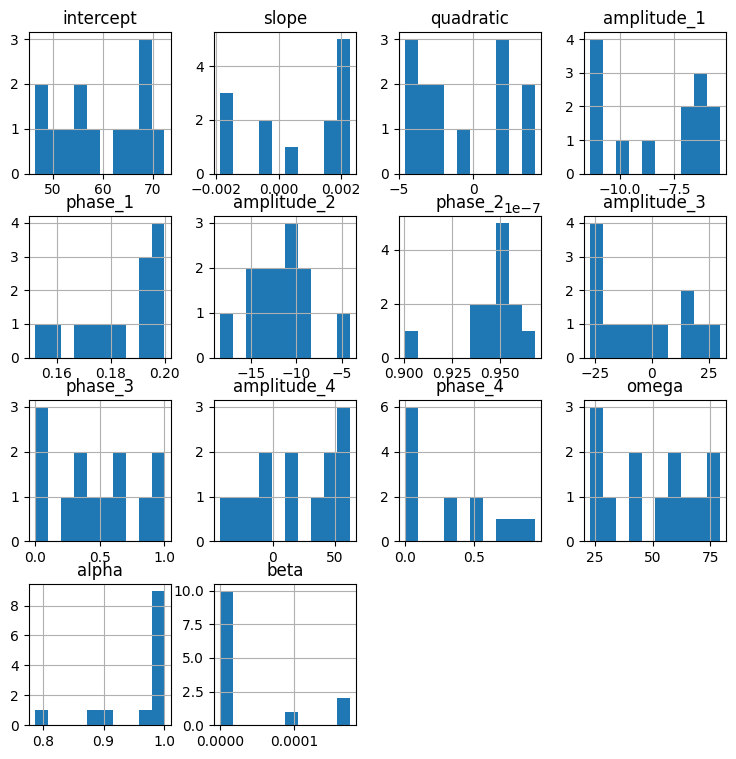

In [12]:
tmp_df = pd.DataFrame(
    {
        station: np.concat(
            [dct_fit_res[station]["fit_mean"].x, dct_fit_res[station]["fit_sgarch"].x]
        )
        for station in SET_USA
    },
    index=[
        "intercept",
        "slope",
        "quadratic",
        "amplitude_1",
        "phase_1",
        "amplitude_2",
        "phase_2",
        "amplitude_3",
        "phase_3",
        "amplitude_4",
        "phase_4",
        "omega",
        "alpha",
        "beta",
    ],
).T
display(tmp_df.describe())
tmp_df.hist(figsize=(9, 9))

## Residuals


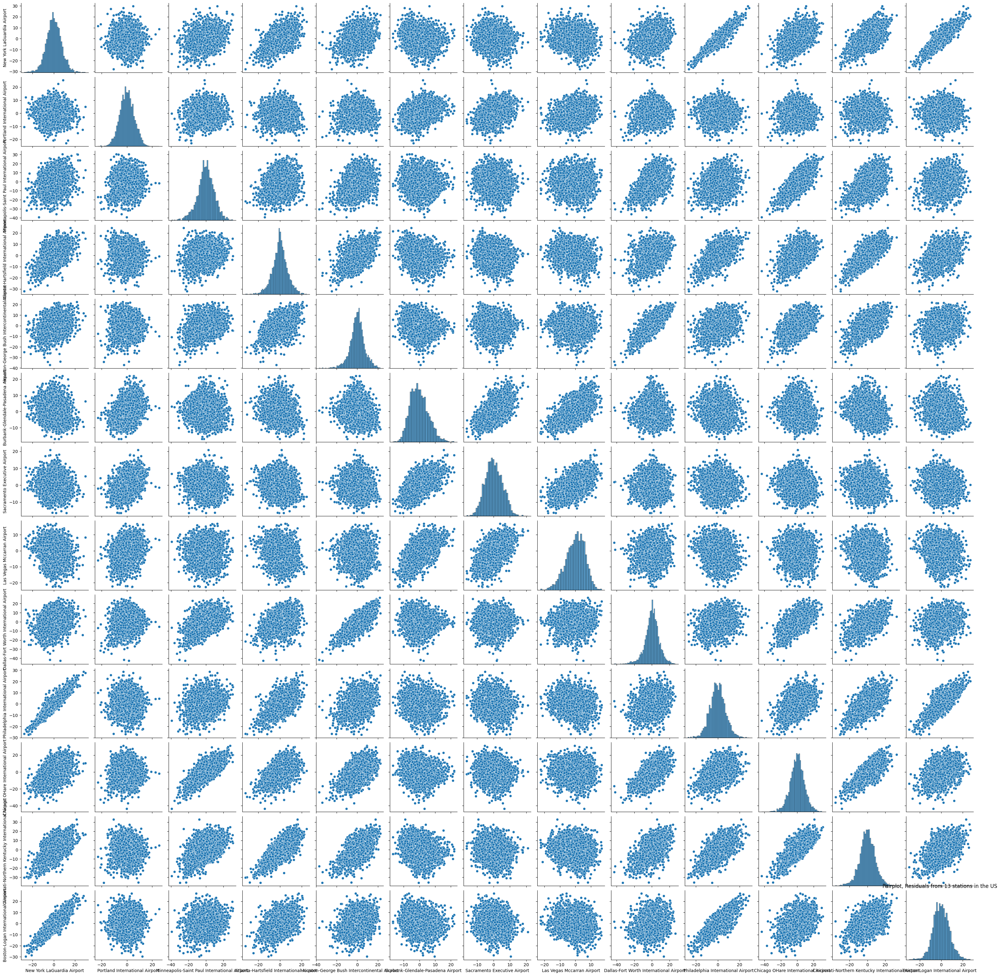

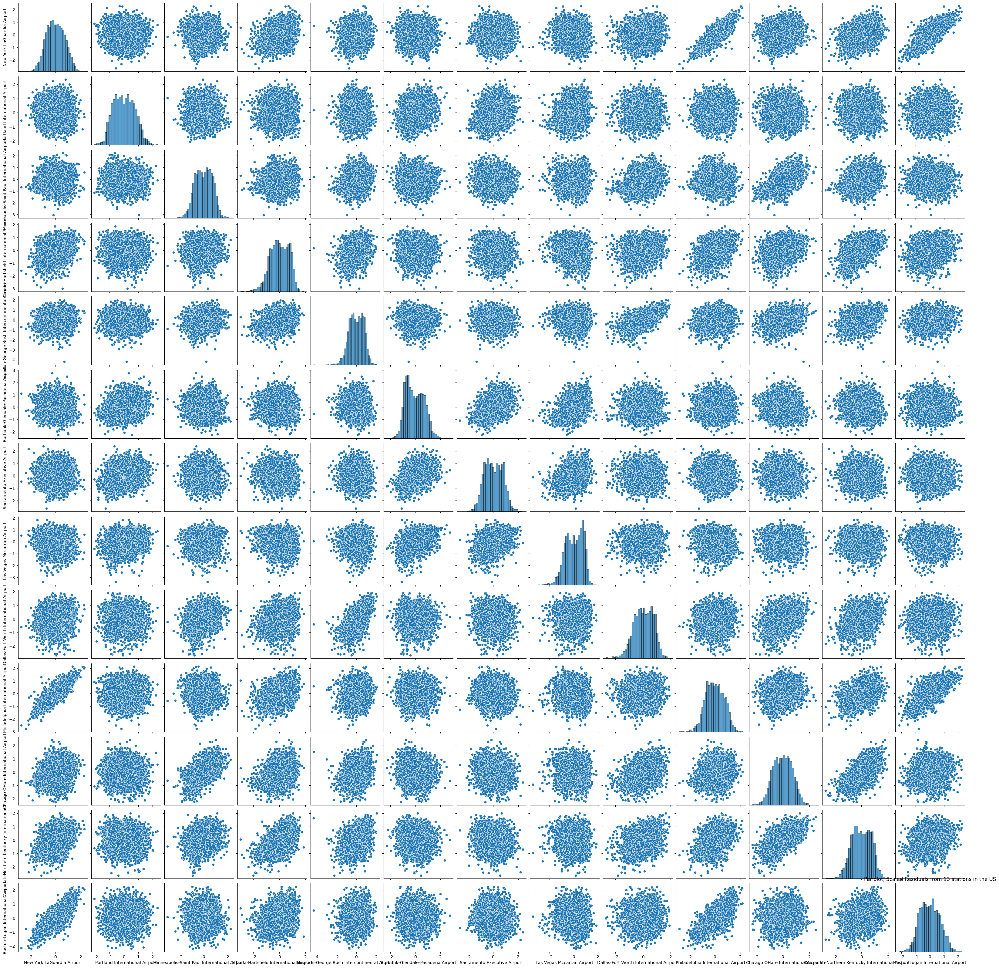

In [11]:
station = "New York LaGuardia Airport"
#
df_res = pd.DataFrame(
    {station: dct_fit_res[station]["vec_res"].values for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
sns.pairplot(df_res)
plt.title("Pairplot, Residuals from 13 stations in the US")
#
df_res_scaled = pd.DataFrame(
    {station: dct_fit_res[station]["vec_res_scaled"].values for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
sns.pairplot(df_res_scaled)
plt.title("Pairplot, Scaled Residuals from 13 stations in the US")
#
df_std = pd.DataFrame(
    {station: dct_fit_res[station]["vec_std"] for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
df_y_pred = pd.DataFrame(
    {station: dct_fit_res[station]["vec_y_pred"] for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)

Text(0.5, 1.0, "Kendall's tau, Residuals from 13 stations in the US")

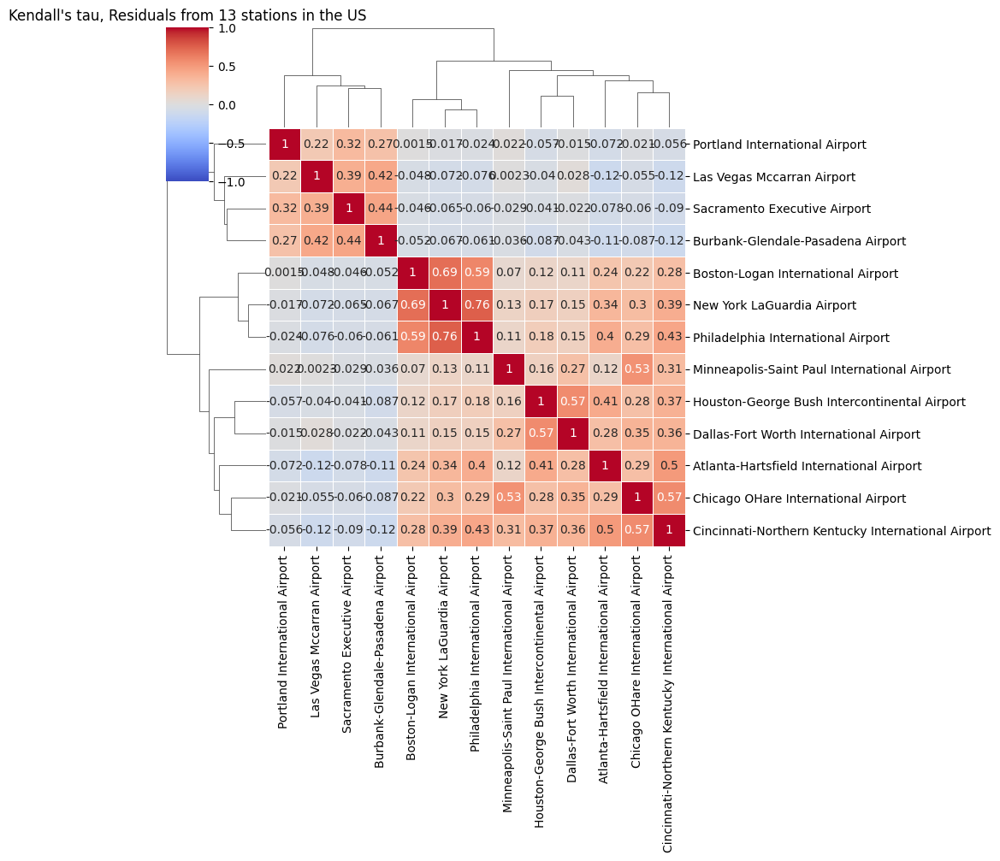

In [15]:
sns.clustermap(
    df_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)
plt.title("Kendall's tau, Residuals from 13 stations in the US")

#### Residuals EVI, Right


In [12]:
dct_evi_res_right = {}
for station in SET_USA:
    tmp_vec = df_res[station].values
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [13]:
df_evi_res_right = pd.DataFrame(dct_evi_res_right).head(7)
df_evi_res_right[df_evi_res_right < 0] = np.abs(df_evi_res_right[df_evi_res_right < 0])
df_evi_res_right[np.isinf(df_evi_res_right)] = np.nan
display(df_evi_res_right)
df_evi_res_right.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,1.010994,0.740831,0.469897,0.187476,1.977795,0.622192,0.659558,0.534950,1.723504,2.425476,0.958763,0.256313,0.591495
schultze_steinebach,0.329083,0.310002,0.403113,0.300535,0.318337,0.153216,0.238438,0.256571,0.323356,0.379223,0.417900,0.427708,0.287686
smith,0.217341,0.145333,0.178849,0.153100,0.164932,0.205004,0.167751,0.147917,0.192994,0.209501,0.182713,0.166657,0.170596
meerschaert_scheffler,0.699114,0.665210,0.727644,0.694674,0.694431,0.683416,0.655677,0.651225,0.703927,0.702215,0.720801,0.719124,0.704988
genextreme,0.101174,0.139081,0.138441,0.075718,0.060525,0.110557,0.179862,0.250416,0.078985,0.087686,0.111086,0.127894,0.128371
genpareto,0.204214,0.204318,0.263208,0.221749,0.219758,0.234391,0.253381,0.352428,0.219208,0.203845,0.235049,0.235725,0.248517
pareto,0.166711,0.158016,0.140720,0.138299,0.138551,0.148242,0.185392,0.166458,0.154037,0.190471,0.156644,0.114641,0.164247


New York LaGuardia Airport                            0.217341
Portland International Airport                        0.204318
Minneapolis-Saint Paul International Airport          0.263208
Atlanta-Hartsfield International Airport              0.187476
Houston-George Bush Intercontinental Airport          0.219758
Burbank-Glendale-Pasadena Airport                     0.205004
Sacramento Executive Airport                          0.238438
Las Vegas Mccarran Airport                            0.256571
Dallas-Fort Worth International Airport               0.219208
Philadelphia International Airport                    0.209501
Chicago OHare International Airport                   0.235049
Cincinnati-Northern Kentucky International Airport    0.235725
Boston-Logan International Airport                    0.248517
dtype: float64

#### Residuals EVI, Left


In [14]:
dct_evi_res_left = {}
for station in SET_USA:
    tmp_vec = df_res[station].values
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [15]:
df_evi_res_left = pd.DataFrame(dct_evi_res_left).head(7)
df_evi_res_left[df_evi_res_left < 0] = np.abs(df_evi_res_left[df_evi_res_left < 0])
df_evi_res_left[np.isinf(df_evi_res_left)] = np.nan
display(df_evi_res_left)
df_evi_res_left.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.050749,0.810526,1.141168,0.070055,1.180711,3.744255,0.096887,2.156576,0.663662,0.277418,0.006890,1.523052,0.182042
schultze_steinebach,0.278232,0.304115,0.361771,0.235325,0.305774,0.226482,0.198564,0.242194,0.308841,0.291545,0.359672,0.318314,0.353228
smith,0.229907,0.166600,0.184573,0.184554,0.228010,0.134512,0.146522,0.172443,0.242676,0.225967,0.229816,0.225055,0.205392
meerschaert_scheffler,0.695994,0.662993,0.745554,0.704443,0.712323,0.642779,0.641351,0.690908,0.732175,0.699179,0.735524,0.729675,0.696209
genextreme,0.077617,0.122805,0.041341,0.000312,0.042821,0.243017,0.194566,0.136720,0.047292,0.085346,0.032761,0.040394,0.105885
genpareto,0.189644,0.215197,0.181847,0.126149,0.078321,0.328427,0.293668,0.261524,0.076113,0.198899,0.143003,0.164720,0.202002
pareto,0.130439,0.114134,0.143628,0.110042,0.142430,0.118267,0.133912,0.129976,0.134345,0.131310,0.153384,0.167567,0.147209


New York LaGuardia Airport                            0.189644
Portland International Airport                        0.215197
Minneapolis-Saint Paul International Airport          0.184573
Atlanta-Hartsfield International Airport              0.126149
Houston-George Bush Intercontinental Airport          0.228010
Burbank-Glendale-Pasadena Airport                     0.243017
Sacramento Executive Airport                          0.194566
Las Vegas Mccarran Airport                            0.242194
Dallas-Fort Worth International Airport               0.242676
Philadelphia International Airport                    0.225967
Chicago OHare International Airport                   0.153384
Cincinnati-Northern Kentucky International Airport    0.225055
Boston-Logan International Airport                    0.202002
dtype: float64

# CDD

max(0, (avgtemp - 65F)), in CDD months


In [17]:
df_cdd = (df_avg_all[df_avg_all.index.month.isin(MONTH_CDD)] - 65).clip(lower=0)
df_cdd.describe()

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
count,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000
mean,9.264574,4.346252,5.990391,12.858104,17.721332,9.096092,8.722293,22.551890,17.367393,9.497438,6.658232,7.813581,5.949071
std,6.696140,5.002314,5.524297,5.127466,5.058838,6.554729,5.821482,8.622879,6.660328,6.489834,5.761355,5.288307,5.890437
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,10.000000,14.500000,3.500000,4.000000,17.000000,13.000000,3.500000,0.000000,3.500000,0.000000
50%,10.000000,2.500000,5.000000,13.500000,18.500000,9.000000,9.000000,24.000000,18.500000,10.000000,6.000000,8.500000,5.000000
75%,14.500000,7.500000,10.000000,16.500000,21.500000,14.000000,12.500000,29.000000,22.000000,14.500000,11.500000,12.000000,10.000000
max,26.500000,30.500000,25.000000,24.000000,30.000000,32.000000,28.500000,40.500000,32.500000,25.000000,22.500000,20.500000,25.500000


Text(0.5, 1.0, 'Pairplot, CDD from 13 stations in the US')

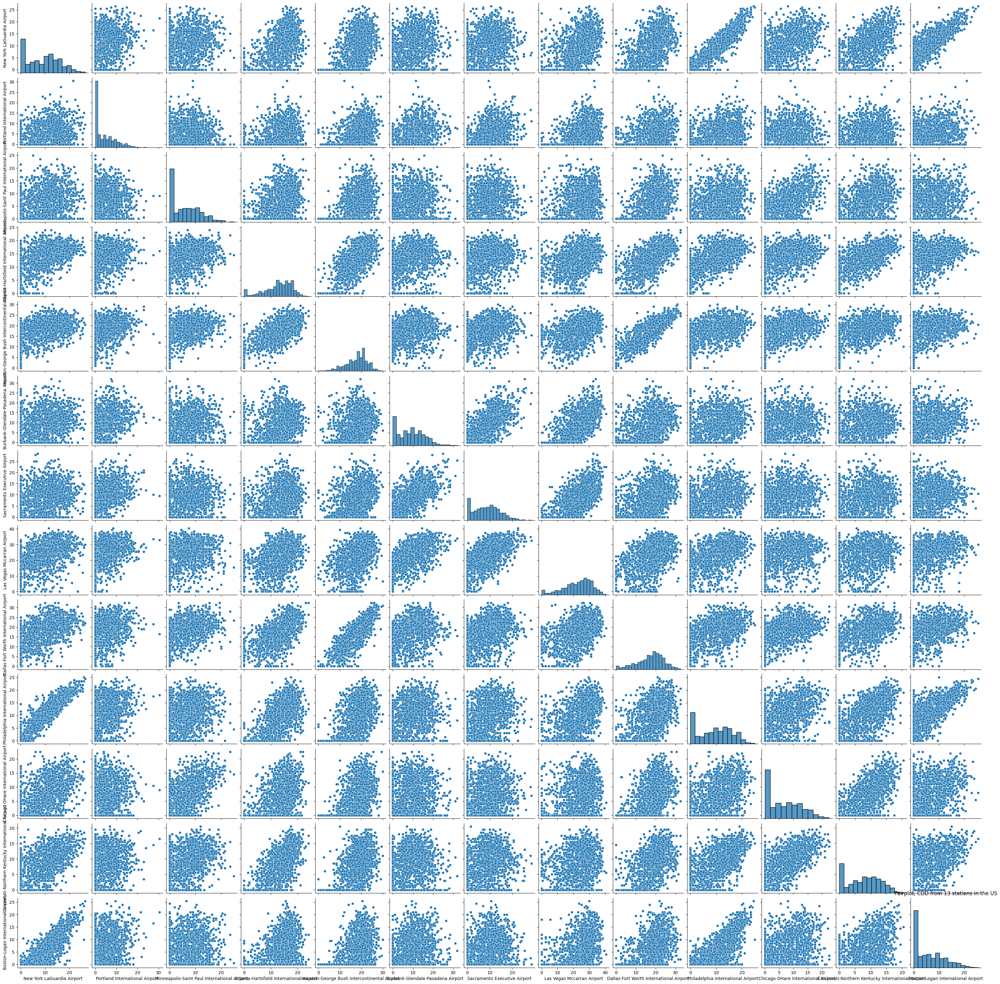

In [18]:
sns.pairplot(df_cdd)
plt.title("Pairplot, CDD from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, CDD from 13 stations in the US")

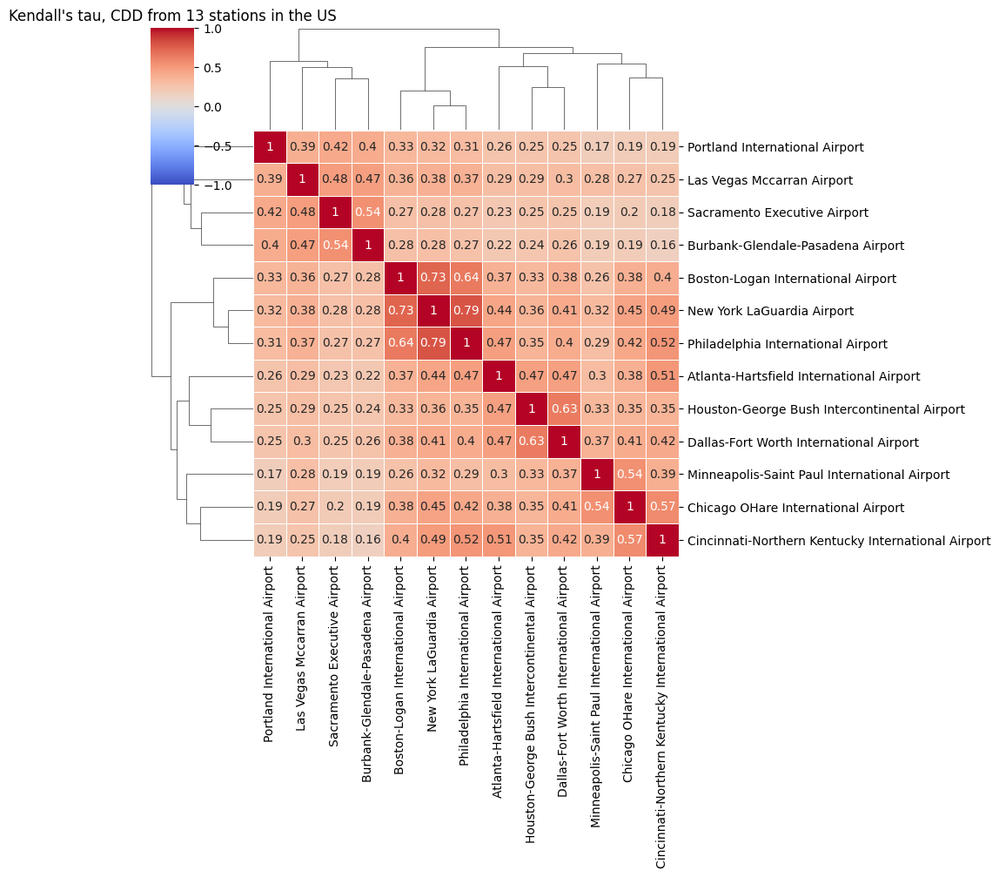

In [22]:
sns.clustermap(
    df_cdd.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)
plt.title("Kendall's tau, CDD from 13 stations in the US")

## CDD EVI


In [19]:
dct_evi_cdd = {}
for station in SET_USA:
    tmp_vec = df_cdd[station].values
    dct_evi_cdd[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

/Users/tycheng/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/WxDerivs/.venv/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:8236: RuntimeWarning: divide by zero encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))
/Users/tycheng/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/WxDerivs/.venv/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:8236: RuntimeWarning: invalid value encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))


In [20]:
df_evi_cdd = pd.DataFrame(dct_evi_cdd).head(7)
df_evi_cdd[df_evi_cdd < 0] = np.abs(df_evi_cdd[df_evi_cdd < 0])
df_evi_cdd[np.isinf(df_evi_cdd)] = np.nan
display(df_evi_cdd)
df_evi_cdd.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,NaN,NaN,NaN,NaN,0.422897,NaN,NaN,NaN,0.407071,NaN,NaN,NaN,NaN
schultze_steinebach,NaN,NaN,NaN,NaN,0.684795,NaN,NaN,NaN,0.656750,NaN,NaN,NaN,NaN
smith,0.110064,0.178896,0.143034,0.068149,0.067468,0.160984,0.135095,0.053210,0.069384,0.084605,0.121005,0.082082,0.128477
meerschaert_scheffler,0.758560,0.718899,0.732397,0.722259,0.720427,0.755657,0.739523,0.792952,0.757830,0.754304,0.738111,0.726460,0.741125
genextreme,0.412145,2.318805,0.063438,0.681502,0.749206,0.290009,0.323441,0.727397,0.676157,0.474367,0.244222,0.474740,5.500061
genpareto,0.527246,2.424306,3.141981,0.885847,0.991101,0.379471,0.415687,0.945941,0.884237,0.588789,0.400698,0.589337,3.355212
pareto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


New York LaGuardia Airport                            0.469695
Portland International Airport                        1.518852
Minneapolis-Saint Paul International Airport          0.437715
Atlanta-Hartsfield International Airport              0.701881
Houston-George Bush Intercontinental Airport          0.702611
Burbank-Glendale-Pasadena Airport                     0.334740
Sacramento Executive Airport                          0.369564
Las Vegas Mccarran Airport                            0.760174
Dallas-Fort Worth International Airport               0.666453
Philadelphia International Airport                    0.531578
Chicago OHare International Airport                   0.322460
Cincinnati-Northern Kentucky International Airport    0.532039
Boston-Logan International Airport                    2.048169
dtype: float64

# CDD Residual: CDD - CDD_pred

> CDD - CDD_prediction, notice both are processed as max(0, avgtemp-65)


Text(0.5, 1.0, 'Pairplot, CDD residuals from 13 stations in the US')

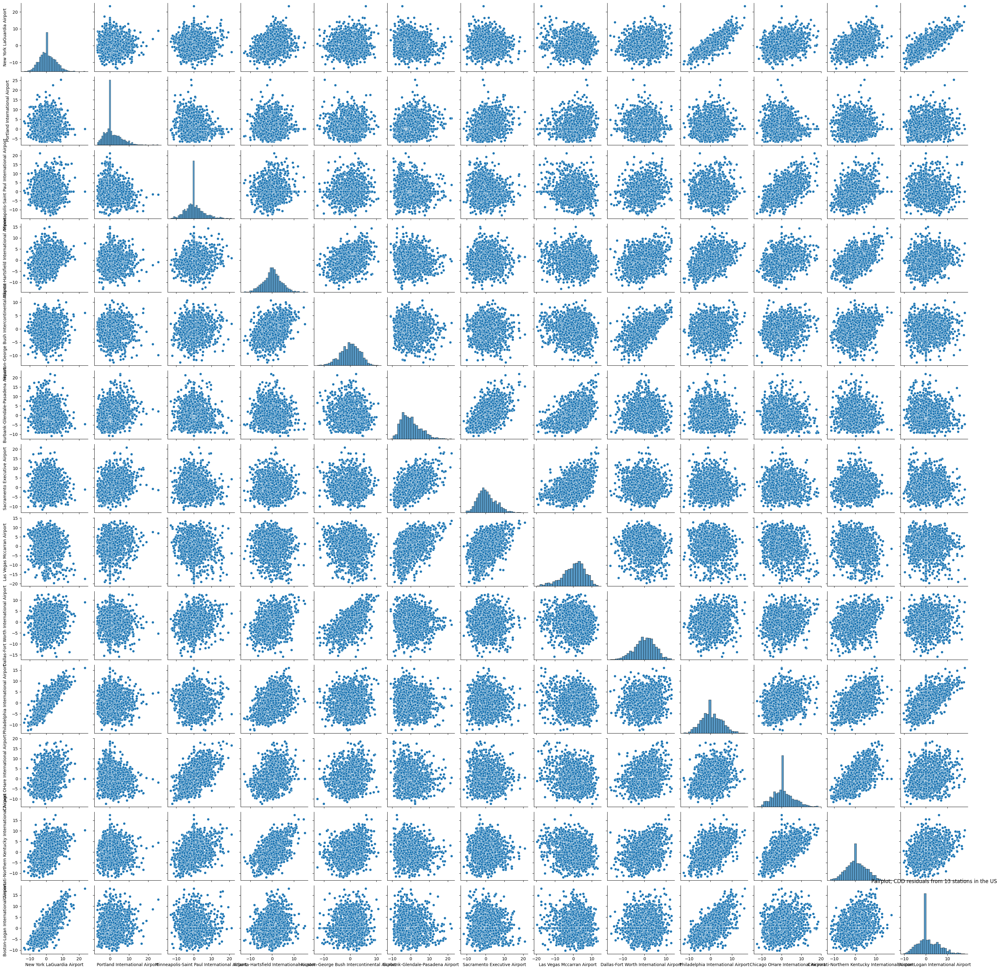

In [21]:
df_cdd_pred = (
    pd.DataFrame(
        {station: dct_fit_res[station]["vec_y_pred"].values for station in SET_USA},
        index=dct_fit_res[station]["vec_index"],
    )
    - 65
).clip(lower=0)
df_cdd_pred = df_cdd_pred[df_cdd_pred.index.month.isin(MONTH_CDD)]
df_cdd_res = df_cdd - df_cdd_pred
sns.pairplot(df_cdd_res)
plt.title("Pairplot, CDD residuals from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, CDD residuals from 13 stations in the US")

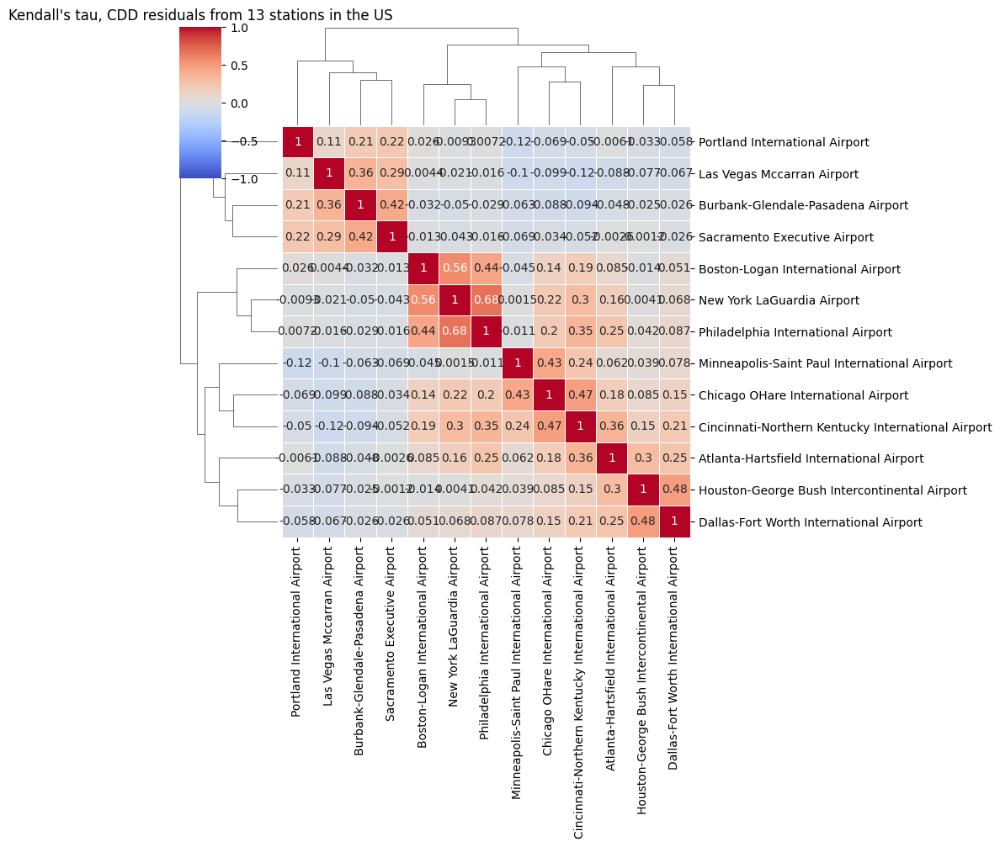

In [22]:
g = sns.clustermap(
    df_cdd_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, CDD residuals from 13 stations in the US")

## CDD Residual EVI, Right


In [23]:
dct_evi_cdd_res_right = {}
for station in SET_USA:
    tmp_vec = df_cdd_res[station].values
    # ! right tail
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_cdd_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [24]:
df_evi_cdd_res_right = pd.DataFrame(dct_evi_cdd_res_right).head(7)
df_evi_cdd_res_right[df_evi_cdd_res_right < 0] = np.abs(
    df_evi_cdd_res_right[df_evi_cdd_res_right < 0]
)
df_evi_cdd_res_right[np.isinf(df_evi_cdd_res_right)] = np.nan
display(df_evi_cdd_res_right)
df_evi_cdd_res_right.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.520047,0.191086,0.071478,1.306482,0.127173,0.089641,0.907608,0.741530,0.059408,0.590271,0.044722,0.976310,0.278499
schultze_steinebach,0.274190,0.350085,0.332721,0.197801,0.322476,0.298651,0.159314,0.212684,0.297555,0.305724,0.321892,0.247430,0.215152
smith,0.178577,0.185132,0.193678,0.180814,0.178528,0.211669,0.208988,0.114425,0.171897,0.147363,0.168184,0.156028,0.203575
meerschaert_scheffler,0.680772,0.699389,0.712377,0.640185,0.603135,0.709852,0.691868,0.658253,0.644502,0.664817,0.701956,0.669223,0.694657
genextreme,0.135786,0.119532,0.050138,0.094535,0.231048,0.089934,0.107572,0.336718,0.230869,0.227864,0.164786,0.209553,0.216808
genpareto,0.205338,0.199143,0.200968,0.213329,0.333323,0.217189,0.225740,0.460476,0.368037,0.335150,0.303499,0.298195,0.341857
pareto,0.228383,0.220524,0.150725,0.150404,0.149381,0.199210,0.187744,0.179573,0.198496,0.233156,0.211866,0.120656,0.238485


New York LaGuardia Airport                            0.228383
Portland International Airport                        0.199143
Minneapolis-Saint Paul International Airport          0.193678
Atlanta-Hartsfield International Airport              0.197801
Houston-George Bush Intercontinental Airport          0.231048
Burbank-Glendale-Pasadena Airport                     0.211669
Sacramento Executive Airport                          0.208988
Las Vegas Mccarran Airport                            0.336718
Dallas-Fort Worth International Airport               0.230869
Philadelphia International Airport                    0.305724
Chicago OHare International Airport                   0.211866
Cincinnati-Northern Kentucky International Airport    0.247430
Boston-Logan International Airport                    0.238485
dtype: float64

## CDD Residual EVI, Left


In [25]:
dct_evi_cdd_res_left = {}
for station in SET_USA:
    tmp_vec = df_cdd_res[station].values
    # ! left tail
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_cdd_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [26]:
df_evi_cdd_res_left = pd.DataFrame(dct_evi_cdd_res_left).head(7)
df_evi_cdd_res_left[df_evi_cdd_res_left < 0] = np.abs(
    df_evi_cdd_res_left[df_evi_cdd_res_left < 0]
)
df_evi_cdd_res_left[np.isinf(df_evi_cdd_res_left)] = np.nan
display(df_evi_cdd_res_left)
df_evi_cdd_res_left.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.950610,0.116539,0.670363,4.812841,0.792781,0.336858,1.393235,1.719315,1.331623,0.767320,0.637713,0.384135,0.389515
schultze_steinebach,0.228016,0.063571,0.163934,0.061724,0.135221,0.193831,0.079096,0.286889,0.197874,0.214515,0.321656,0.200411,0.183415
smith,0.183455,0.086585,0.171646,0.135704,0.164879,0.133830,0.127897,0.127528,0.160209,0.125808,0.092133,0.153551,0.102821
meerschaert_scheffler,0.638854,0.582548,0.655255,0.638889,0.634673,0.617309,0.625365,0.728694,0.670247,0.641188,0.651576,0.646532,0.633289
genextreme,0.201623,0.368418,0.217500,0.125157,0.127258,0.366411,0.239464,0.104711,0.152054,0.239238,0.310322,0.238853,0.309318
genpareto,0.307977,0.548939,0.360498,0.269957,0.268660,0.477973,0.363201,0.296813,0.289526,0.363003,0.421945,0.392405,0.451499
pareto,0.137818,0.155369,0.158436,0.170558,0.153580,0.191954,0.154604,0.130096,0.141117,0.138981,0.205971,0.184802,0.196036


New York LaGuardia Airport                            0.228016
Portland International Airport                        0.155369
Minneapolis-Saint Paul International Airport          0.217500
Atlanta-Hartsfield International Airport              0.170558
Houston-George Bush Intercontinental Airport          0.164879
Burbank-Glendale-Pasadena Airport                     0.336858
Sacramento Executive Airport                          0.239464
Las Vegas Mccarran Airport                            0.286889
Dallas-Fort Worth International Airport               0.197874
Philadelphia International Airport                    0.239238
Chicago OHare International Airport                   0.321656
Cincinnati-Northern Kentucky International Airport    0.238853
Boston-Logan International Airport                    0.309318
dtype: float64

# HDD

max(0, (65F - avgtemp)), in HDD months


In [27]:
df_hdd = (65 - df_avg_all[df_avg_all.index.month.isin(MONTH_HDD)]).clip(lower=0)
df_hdd.describe()

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
count,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000
mean,23.881160,20.267623,39.055209,13.523706,7.564566,6.759513,13.176544,10.625390,12.372739,23.787898,31.925764,25.939177,27.876482
std,10.060107,6.416548,14.173294,9.415323,8.049785,5.224698,5.595195,6.910761,10.102256,10.040411,12.683403,11.995456,10.198943
min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,16.000000,30.000000,5.500000,0.000000,2.000000,9.000000,5.000000,3.500000,17.000000,24.000000,18.000000,21.500000
50%,23.500000,20.000000,37.000000,13.500000,5.500000,6.500000,13.500000,11.000000,11.500000,23.500000,30.500000,25.000000,27.500000
75%,30.000000,24.000000,47.500000,20.500000,13.000000,10.500000,17.000000,15.500000,19.000000,30.000000,39.000000,33.500000,34.500000
max,56.000000,47.000000,85.500000,49.000000,44.500000,22.500000,28.500000,28.000000,57.000000,56.500000,81.500000,65.000000,63.500000


Text(0.5, 1.0, 'Pairplot, HDD from 13 stations in the US')

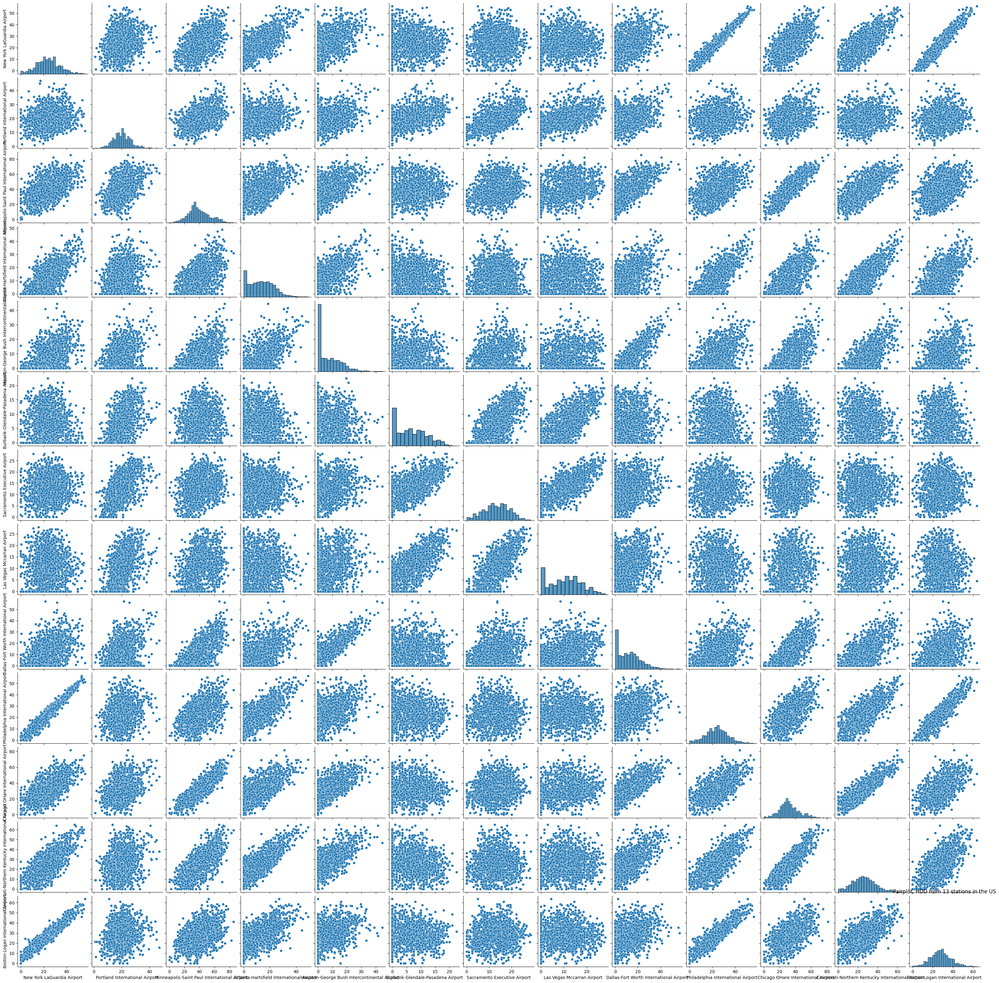

In [28]:
sns.pairplot(df_hdd)
plt.title("Pairplot, HDD from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, HDD from 13 stations in the US")

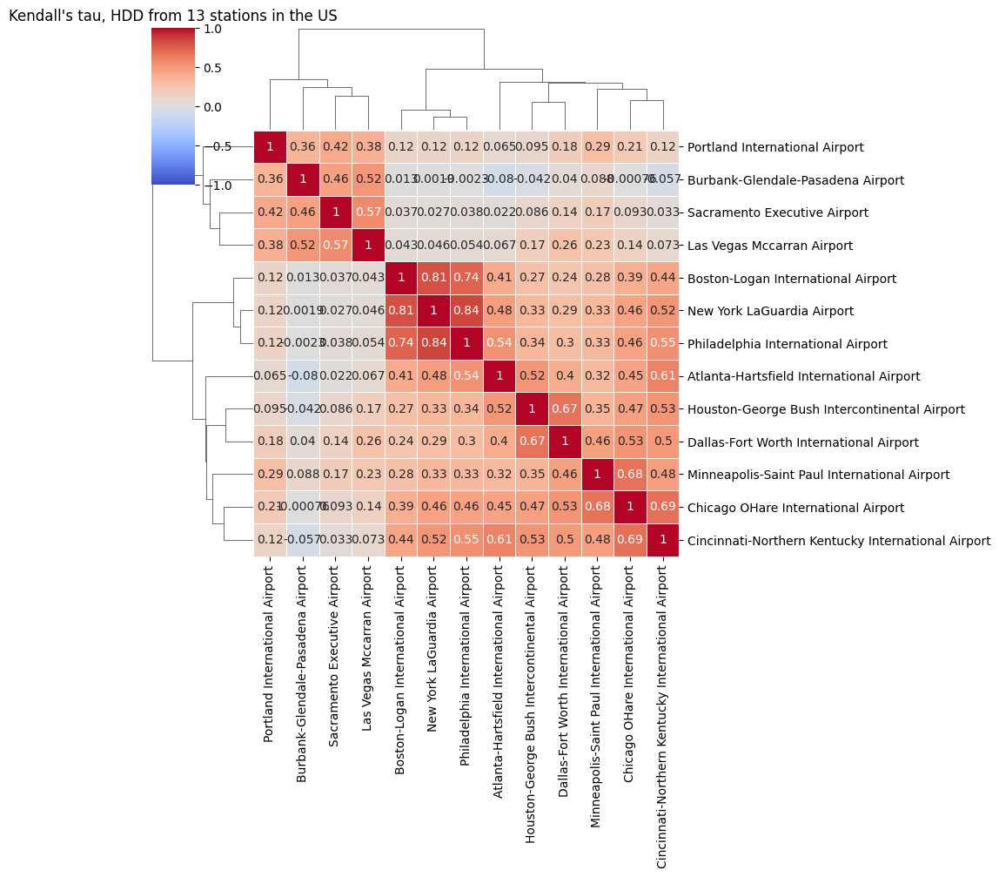

In [29]:
g = sns.clustermap(
    df_hdd.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, HDD from 13 stations in the US")

## HDD EVI


In [30]:
dct_evi_hdd = {}
for station in SET_USA:
    tmp_vec = df_hdd[station].values
    dct_evi_hdd[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

/Users/tycheng/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/WxDerivs/.venv/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:8236: RuntimeWarning: divide by zero encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))
/Users/tycheng/Library/CloudStorage/OneDrive-NationalUniversityofSingapore/WxDerivs/.venv/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:8236: RuntimeWarning: invalid value encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))


In [31]:
df_evi_hdd = pd.DataFrame(dct_evi_hdd).head(7)
df_evi_hdd[df_evi_hdd < 0] = np.abs(df_evi_hdd[df_evi_hdd < 0])
df_evi_hdd[np.isinf(df_evi_hdd)] = np.nan
display(df_evi_hdd)
df_evi_hdd.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.036760,0.240302,0.427384,NaN,NaN,0.568926,0.647685,NaN,NaN,0.072536,0.346634,0.313166,0.158216
schultze_steinebach,0.728972,0.675272,0.818442,NaN,NaN,0.477063,0.563021,NaN,NaN,0.718148,0.756207,0.699529,0.782403
smith,0.116969,0.123606,0.071155,0.170514,0.201109,0.102371,0.092869,0.087908,0.172451,0.125919,0.103249,0.131269,0.107083
meerschaert_scheffler,0.812789,0.751851,0.859238,0.803813,0.782580,0.724006,0.733290,0.761906,0.813355,0.812523,0.844188,0.836631,0.814646
genextreme,0.475150,0.453032,0.509713,0.274940,3.085821,0.321934,0.541276,0.459618,0.151575,0.465143,0.408528,0.438480,0.478428
genpareto,0.623390,0.602483,0.672535,0.360671,5.136412,0.422721,0.704812,0.584168,0.249281,0.610097,0.538911,0.574142,0.631332
pareto,NaN,0.338767,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


New York LaGuardia Airport                            0.549270
Portland International Airport                        0.453032
Minneapolis-Saint Paul International Airport          0.591124
Atlanta-Hartsfield International Airport              0.317806
Houston-George Bush Intercontinental Airport          1.934200
Burbank-Glendale-Pasadena Airport                     0.449892
Sacramento Executive Airport                          0.605353
Las Vegas Mccarran Airport                            0.521893
Dallas-Fort Worth International Airport               0.210866
Philadelphia International Airport                    0.537620
Chicago OHare International Airport                   0.473719
Cincinnati-Northern Kentucky International Airport    0.506311
Boston-Logan International Airport                    0.554880
dtype: float64

# HDD Residual: HDD - HDD_pred

> HDD - HDD_prediction, notice both are processed as max(0, 65-avgtemp)


Text(0.5, 1.0, 'Pairplot, HDD residuals from 13 stations in the US')

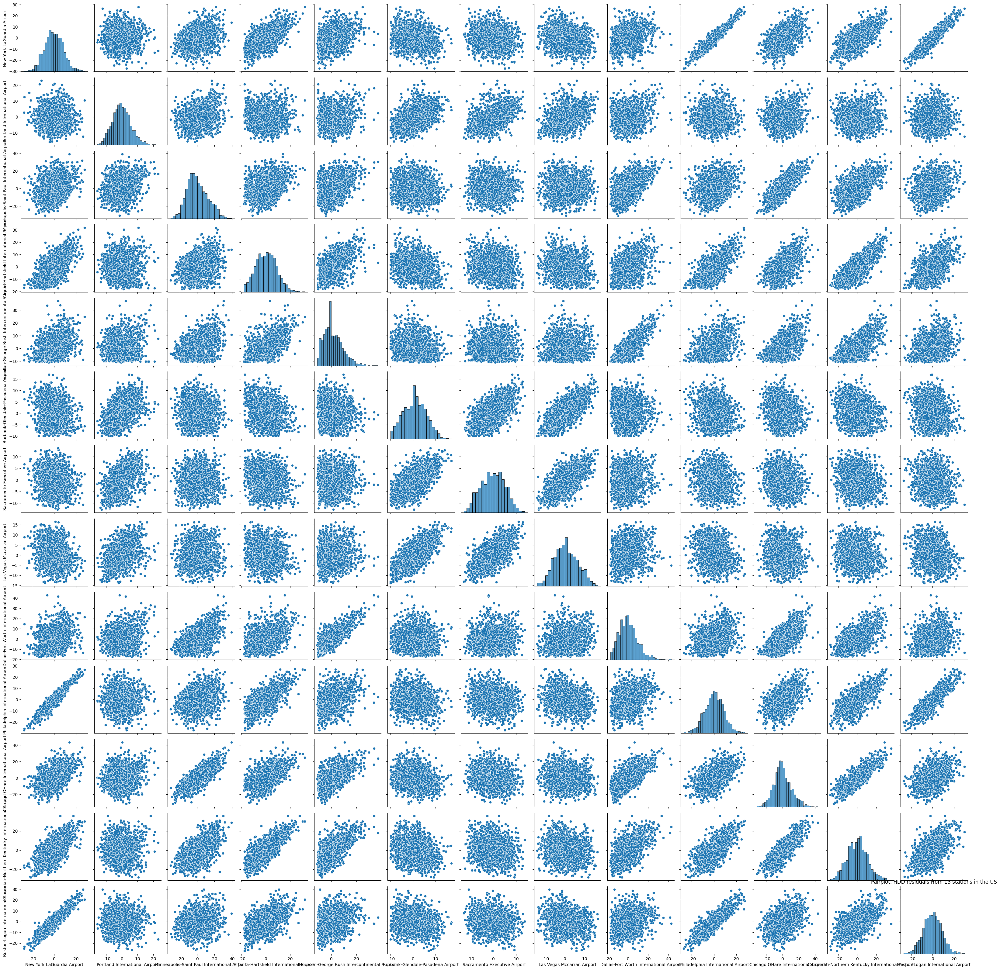

In [32]:
df_hdd_pred = (
    65
    - pd.DataFrame(
        {station: dct_fit_res[station]["vec_y_pred"].values for station in SET_USA},
        index=dct_fit_res[station]["vec_index"],
    )
).clip(lower=0)
df_hdd_pred = df_hdd_pred[df_hdd_pred.index.month.isin(MONTH_HDD)]
df_hdd_res = df_hdd - df_hdd_pred
sns.pairplot(df_hdd_res)
plt.title("Pairplot, HDD residuals from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, HDD residuals from 13 stations in the US")

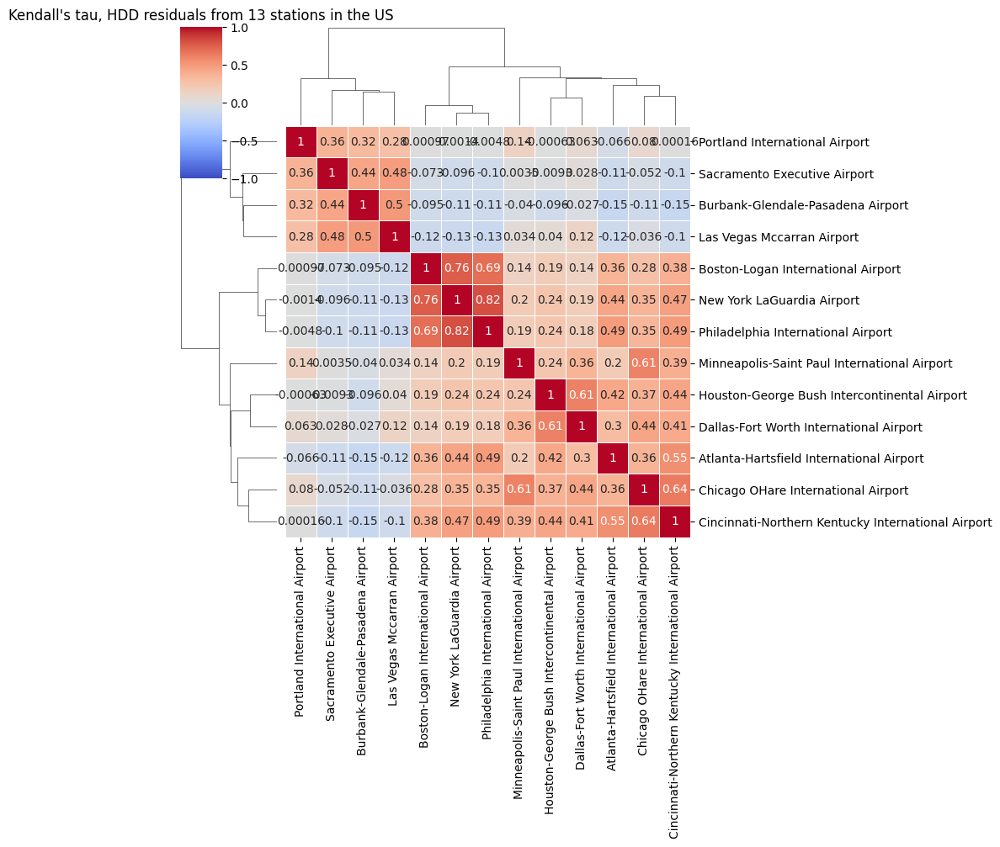

In [33]:
g = sns.clustermap(
    df_hdd_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, HDD residuals from 13 stations in the US")

## HDD Residual EVI, Right


In [34]:
dct_evi_hdd_res_right = {}
for station in SET_USA:
    tmp_vec = df_hdd_res[station].values
    # ! right tail
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_hdd_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [35]:
df_evi_hdd_res_right = pd.DataFrame(dct_evi_hdd_res_right).head(7)
df_evi_hdd_res_right[df_evi_hdd_res_right < 0] = np.abs(
    df_evi_hdd_res_right[df_evi_hdd_res_right < 0]
)
df_evi_hdd_res_right[np.isinf(df_evi_hdd_res_right)] = np.nan
display(df_evi_hdd_res_right)
df_evi_hdd_res_right.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.464261,0.985824,0.407834,0.650540,2.012494,0.627468,0.588878,0.041764,0.783256,0.382079,1.124005,1.549380,0.521745
schultze_steinebach,0.221589,0.286126,0.476896,0.201509,0.403133,0.182209,0.128783,0.220699,0.367865,0.256250,0.395125,0.369569,0.319596
smith,0.193224,0.186774,0.131520,0.190795,0.211228,0.129737,0.153015,0.112815,0.161674,0.189369,0.163819,0.135604,0.225418
meerschaert_scheffler,0.747287,0.708282,0.811259,0.750124,0.765888,0.671453,0.654832,0.692969,0.787998,0.749537,0.804962,0.786469,0.749848
genextreme,0.133220,0.074034,0.241697,0.137060,0.101961,0.223613,0.279403,0.292534,0.035370,0.121769,0.098865,0.110340,0.128132
genpareto,0.263381,0.203113,0.349922,0.244589,0.207869,0.327712,0.402944,0.425885,0.158072,0.257746,0.223316,0.254615,0.250480
pareto,0.160502,0.150189,0.178423,0.105452,0.145797,0.149008,0.132930,0.202050,0.186406,0.152381,0.147710,0.187131,0.142931


New York LaGuardia Airport                            0.221589
Portland International Airport                        0.203113
Minneapolis-Saint Paul International Airport          0.349922
Atlanta-Hartsfield International Airport              0.201509
Houston-George Bush Intercontinental Airport          0.211228
Burbank-Glendale-Pasadena Airport                     0.223613
Sacramento Executive Airport                          0.279403
Las Vegas Mccarran Airport                            0.220699
Dallas-Fort Worth International Airport               0.186406
Philadelphia International Airport                    0.256250
Chicago OHare International Airport                   0.223316
Cincinnati-Northern Kentucky International Airport    0.254615
Boston-Logan International Airport                    0.250480
dtype: float64

## HDD Residual EVI, Left


In [36]:
dct_evi_hdd_res_left = {}
for station in SET_USA:
    tmp_vec = df_hdd_res[station].values
    # ! left tail
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_hdd_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [37]:
df_evi_hdd_res_left = pd.DataFrame(dct_evi_hdd_res_left).head(7)
df_evi_hdd_res_left[df_evi_hdd_res_left < 0] = np.abs(
    df_evi_hdd_res_left[df_evi_hdd_res_left < 0]
)
df_evi_hdd_res_left[np.isinf(df_evi_hdd_res_left)] = np.nan
display(df_evi_hdd_res_left)
df_evi_hdd_res_left.median(axis=0)

,New York LaGuardia Airport,Portland International Airport,Minneapolis-Saint Paul International Airport,Atlanta-Hartsfield International Airport,Houston-George Bush Intercontinental Airport,Burbank-Glendale-Pasadena Airport,Sacramento Executive Airport,Las Vegas Mccarran Airport,Dallas-Fort Worth International Airport,Philadelphia International Airport,Chicago OHare International Airport,Cincinnati-Northern Kentucky International Airport,Boston-Logan International Airport
hill,0.130729,0.493225,0.671998,1.004281,0.633101,1.095723,0.976964,1.240986,0.500401,0.913266,0.187423,0.759780,0.362472
schultze_steinebach,0.333442,0.322392,0.514832,0.391666,0.216585,0.204068,0.230058,0.277055,0.338584,0.343286,0.465075,0.500854,0.269124
smith,0.156541,0.127222,0.175835,0.085554,0.060373,0.062707,0.098724,0.136699,0.073239,0.174230,0.150546,0.117674,0.170373
meerschaert_scheffler,0.738693,0.674020,0.762775,0.723551,0.662531,0.645114,0.659727,0.665102,0.719214,0.751315,0.761555,0.770271,0.744936
genextreme,0.178371,0.251525,0.252921,0.396735,0.524819,0.434170,0.368020,0.254177,0.393953,0.146039,0.147505,0.260765,0.175624
genpareto,0.288679,0.380581,0.367042,0.585749,0.669028,0.625795,0.496738,0.403264,0.576310,0.283700,0.278807,0.401859,0.300834
pareto,0.167897,0.191518,0.180431,0.147017,0.153571,0.152364,0.194585,0.169821,0.168716,0.184640,0.153111,0.150587,0.167437


New York LaGuardia Airport                            0.178371
Portland International Airport                        0.322392
Minneapolis-Saint Paul International Airport          0.367042
Atlanta-Hartsfield International Airport              0.396735
Houston-George Bush Intercontinental Airport          0.524819
Burbank-Glendale-Pasadena Airport                     0.434170
Sacramento Executive Airport                          0.368020
Las Vegas Mccarran Airport                            0.277055
Dallas-Fort Worth International Airport               0.393953
Philadelphia International Airport                    0.283700
Chicago OHare International Airport                   0.187423
Cincinnati-Northern Kentucky International Airport    0.401859
Boston-Logan International Airport                    0.269124
dtype: float64

# Comparison of EVI


<Axes: >

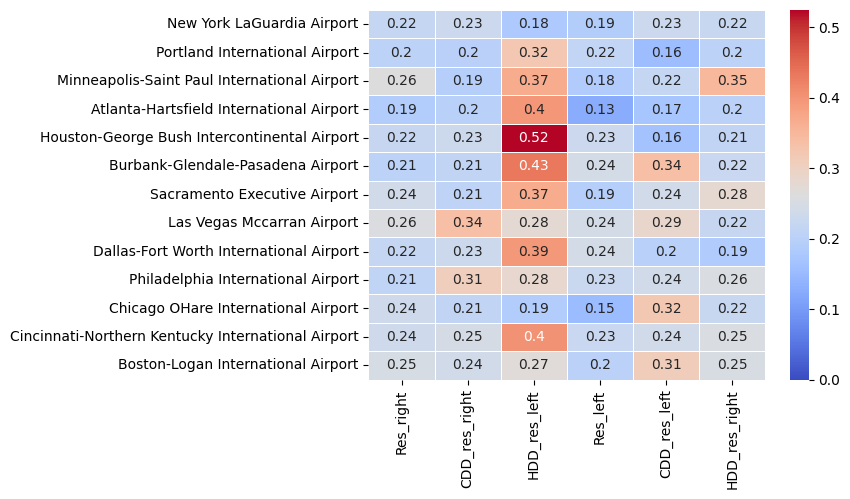

In [39]:
df_evi_all = pd.DataFrame(
    {
        # "CDD": df_evi_cdd.median(axis=0),
        # "HDD": df_evi_hdd.median(axis=0),
        # * due to temp obs >> temp expected
        "Res_right": df_evi_res_right.median(axis=0),  # all seasons
        "CDD_res_right": df_evi_cdd_res_right.median(axis=0),  # summer
        "HDD_res_left": df_evi_hdd_res_left.median(axis=0),  # winter
        # * due to temp obs << temp expected
        "Res_left": df_evi_res_left.median(axis=0),  # all seasons
        "CDD_res_left": df_evi_cdd_res_left.median(axis=0),  # summer
        "HDD_res_right": df_evi_hdd_res_right.median(axis=0),  # winter
    }
)
sns.heatmap(df_evi_all, annot=True, cmap="coolwarm", linewidths=0.5, vmin=0)

In [40]:
df_evi_all.describe()

,Res_right,CDD_res_right,HDD_res_left,Res_left,CDD_res_left,HDD_res_right
count,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000
mean,0.226163,0.233985,0.338820,0.205572,0.238960,0.237088
std,0.022331,0.042536,0.098467,0.035791,0.059926,0.042733
min,0.187476,0.193678,0.178371,0.126149,0.155369,0.186406
25%,0.209501,0.208988,0.277055,0.189644,0.197874,0.211228
50%,0.219758,0.228383,0.367042,0.215197,0.238853,0.223316
75%,0.238438,0.238485,0.396735,0.228010,0.286889,0.254615
max,0.263208,0.336718,0.524819,0.243017,0.336858,0.349922


# TDC, tail dep coeff


In [43]:
def ferreira_tail_dep_coeff(x: torch.Tensor, y: torch.Tensor) -> float:
    """pairwise tail dependence coefficient (λ) estimator, max of rotation 0, 90, 180, 270
    x and y are both of shape (n, 1) inside (0, 1)
    symmetric for (x,y), (y,1-x), (1-x,1-y), (1-y,x), (y,x), (1-x,y), (1-y,1-x), (x,1-y)
    Ferreira, M.S., 2013. Nonparametric estimation of the tail-dependence coefficient;
    """
    x1 = 1 - x
    y1 = 1 - y
    return (
        3
        - (
            1
            - torch.as_tensor(
                [
                    torch.max(x, y).mean(),
                    torch.max(y, x1).mean(),
                    torch.max(x1, y1).mean(),
                    torch.max(y1, x).mean(),
                ]
            )
            .clamp(0.5, 0.6666666666666666)
            .min()
        ).reciprocal()
    ).item()

## CDD Residual TDC: CDD - CDD_pred


Text(0.5, 1.0, "Ferreira's TDC, CDD residuals from 13 stations in the US")

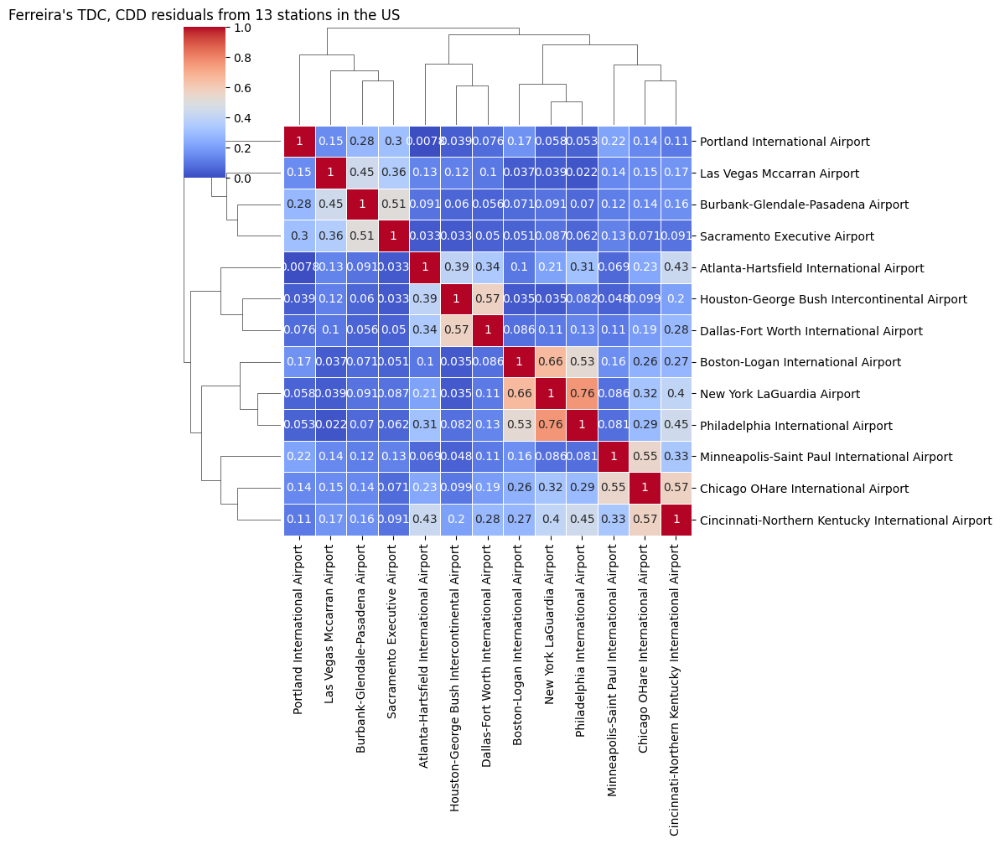

In [44]:
df_cop = df_cdd_res.apply(lambda vec: unibm.cdf_func_kernel(vec)(vec))
df_tdc_cdd_res = df_cop.corr(
    method=lambda x, y: ferreira_tail_dep_coeff(torch.tensor(x), torch.tensor(y))
)
g = sns.clustermap(
    df_tdc_cdd_res,
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=0,
    vmax=1,
)
plt.title("Ferreira's TDC, CDD residuals from 13 stations in the US")

## HDD Residual TDC: HDD - HDD_pred


Text(0.5, 1.0, "Ferreira's TDC, HDD residuals from 13 stations in the US")

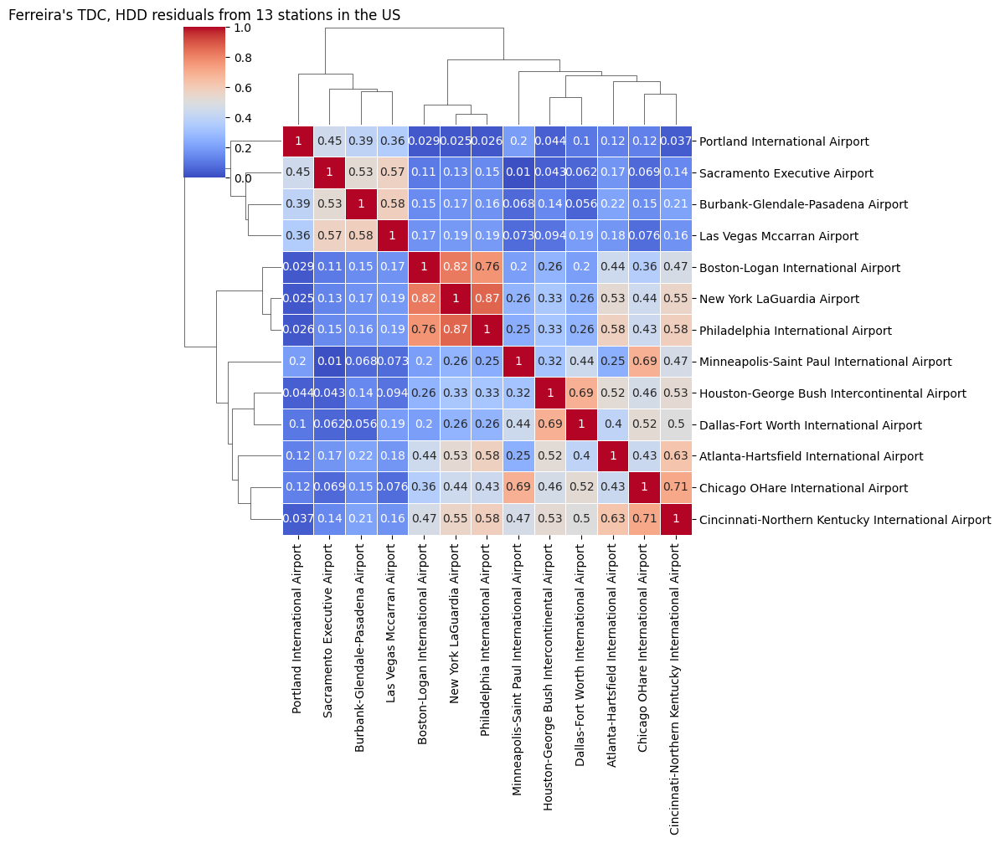

In [45]:
df_cop = df_hdd_res.apply(lambda vec: unibm.cdf_func_kernel(vec)(vec))
df_tdc_hdd_res = df_cop.corr(
    method=lambda x, y: ferreira_tail_dep_coeff(torch.tensor(x), torch.tensor(y))
)
g = sns.clustermap(
    df_tdc_hdd_res,
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=0,
    vmax=1,
)
plt.title("Ferreira's TDC, HDD residuals from 13 stations in the US")

In [46]:
tmp = df_tdc_cdd_res.melt().value
tmp = tmp[tmp < 1]
tmp.describe()

count    156.000000
mean       0.193398
std        0.169213
min        0.007775
25%        0.070932
50%        0.127928
75%        0.282044
max        0.759805
Name: value, dtype: float64

In [47]:
tmp = df_tdc_hdd_res.melt().value
tmp = tmp[tmp < 1]
tmp.describe()

count    156.000000
mean       0.306352
std        0.216679
min        0.010358
25%        0.142893
50%        0.246288
75%        0.465918
max        0.865964
Name: value, dtype: float64

# IO


In [41]:
import pickle

dct_all = {
    #
    "df_avg_all": df_avg_all,
    "df_max_all": df_max_all,
    "df_min_all": df_min_all,
    #
    "dct_fit_res": dct_fit_res,
    "df_y": df_y,
    "df_y_pred": df_y_pred,
    "df_res": df_res,
    "df_std": df_std,
    "df_res_scaled": df_res_scaled,
    #
    "df_cdd": df_cdd,
    "df_cdd_pred": df_cdd_pred,
    "df_cdd_res": df_cdd_res,
    "df_hdd": df_hdd,
    "df_hdd_pred": df_hdd_pred,
    "df_hdd_res": df_hdd_res,
    #
    "df_evi_all": df_evi_all,
}
file_out = DIR_WORK / "out" / "res_CDD_HDD.pkl"
file_out.parent.mkdir(parents=True, exist_ok=True)
pickle.dump(dct_all, open(file_out, "wb"))